In [1]:
import numpy as np
import tensorflow as tf

import os
# np.random.seed(1337)  # for reproducibility
# tf.random.set_seed(1337)
# os.environ['TF_DETERMINISTIC_OPS'] = '1'
# os.environ['TF_CUDNN_DETERMINISTIC '] = '1'


# os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
# os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

In [2]:
base_coin_str = 'BTC'
base_coin_fullname_str = 'bitcoin'

In [3]:
from data.utils import load_data
from data.scaling import normalize

filtro_tipos_eventos_permitidos = ['listing', 'launch', 'fork']
query_str = 'title.isna()'
for filtro in filtro_tipos_eventos_permitidos:
    query_str += f' or title.str.lower().str.contains("{filtro}")'
    # df = df.query(f'event_title.isna() or event_title.str.lower().str.contains("{filtro}")')
print(query_str)

title.isna() or title.str.lower().str.contains("listing") or title.str.lower().str.contains("launch") or title.str.lower().str.contains("fork")


In [4]:
df = load_data(base_coin_str, base_coin_fullname_str, event_days_left_lookback=7, storage_folder='../data', events_query=query_str)
prices, _ = normalize(df.loc[:, 'price'].to_numpy())
variation = df.loc[:, 'price (%)'].to_numpy()
# variation = df.loc[:, 'price'].pct_change().fillna(0).to_numpy()
volume, _ = normalize(df['Volume'].to_numpy())
volume_variation = df['Volume'].pct_change().fillna(0).to_numpy()
tweet, _ = normalize(df.loc[:, 'tweet_volume'].to_numpy())
tweet_variation = df.loc[:, 'tweet_volume'].pct_change().fillna(0).to_numpy()
google_trends, _ = normalize(df.loc[:, 'trend'].to_numpy())
google_trends_variation = df.loc[:, 'trend'].pct_change().fillna(0).to_numpy()

In [5]:
STOCHk_7, _ = normalize(df['STOCHk_7'].fillna(50.0).to_numpy())
STOCHk_15, _ = normalize(df['STOCHk_15'].fillna(50.0).to_numpy())
STOCHk_30, _ = normalize(df['STOCHk_30'].fillna(50.0).to_numpy())
STOCHk_60, _ = normalize(df['STOCHk_60'].fillna(50.0).to_numpy())

RSI_7, _ = normalize(df['RSI_7'].fillna(50.0).to_numpy())
RSI_15, _ = normalize(df['RSI_15'].fillna(50.0).to_numpy())
RSI_30, _ = normalize(df['RSI_30'].fillna(50.0).to_numpy())
RSI_60, _ = normalize(df['RSI_60'].fillna(50.0).to_numpy())

STOCHRSI_7, _ = normalize(df['STOCHRSI_7'].fillna(50.0).to_numpy())
STOCHRSI_15, _ = normalize(df['STOCHRSI_15'].fillna(50.0).to_numpy())
STOCHRSI_30, _ = normalize(df['STOCHRSI_30'].fillna(50.0).to_numpy())
STOCHRSI_60, _ = normalize(df['STOCHRSI_60'].fillna(50.0).to_numpy())

In [5]:
from typing import Tuple
# look_behind: passos (dias) anteriores usados para prever o proximo.
N = 30
foward_days = 1  # quantos dias prever

def to_keras_format(features: list, target) -> Tuple[np.array, np.array]:
    n_samples = len(target) - N - (foward_days-1)
    # matriz de dimensao: [n_samples, N, n_features];
    features_set = np.empty((n_samples, N, len(features)))  # type: np.ndarray
    labels = [None]*n_samples
    for i in range(n_samples):
        for j in range(N):
            for ft_idx in range(len(features)):
                feature = features[ft_idx]
                features_set[i, j, ft_idx] = feature[i+j]

        labels[i] = target[N+i-1: N+i+foward_days]
    labels = np.array(labels)

    return features_set, labels

In [6]:
from keras.models import Model
from keras.layers import Input, LSTM, Dropout, Dense

def build_model(train_X, train_y) -> Model:
    inputs = Input(shape=train_X.shape[1:])
    lstm = LSTM(units=750, return_sequences=False, input_shape=train_X.shape[1:])(inputs)
    lstm = Dropout(0.1)(lstm)
    x = Dense(units=175, activation='linear')(lstm)
    x = Dropout(0.1)(x)
    x = Dense(units=75, activation='linear')(x)
    x = Dropout(0.1)(x)
    x = Dense(units=foward_days)(x)
    return Model(inputs=inputs, outputs=x)

In [25]:
from matplotlib import pyplot as plt
# vizualizando estatisticas do modelo em si e seu treino
def plot_train_history(modelo: Model, plot_above_or_below_zero_accuracy: bool, plotValidation = True, figsize=(25,10)):
    plt.rcParams['figure.figsize'] = figsize
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2)

    ax1.plot(modelo.history.history['loss'])
    if plotValidation: ax1.plot(modelo.history.history['val_loss'])
    ax1.title.set_text('model loss')
    ax1.set_ylabel('loss')
    ax1.set_xlabel('epoch')
    ax1.legend(['train', 'test'], loc='upper left')

    ax2.plot(modelo.history.history['mean_squared_error'])
    if plotValidation: ax2.plot(modelo.history.history['val_mean_squared_error'])
    ax2.title.set_text('model meanSquaredError')
    ax2.set_ylabel('mse')
    ax2.set_xlabel('epoch')
    ax2.legend(['train', 'test'], loc='upper left')

    ax3.plot(modelo.history.history['movement_accuracy'])
    if plotValidation: ax3.plot(modelo.history.history['val_movement_accuracy'])
    ax3.title.set_text('model movement direction accuracy')
    ax3.set_ylabel('accuracy')
    ax3.set_xlabel('epoch')
    ax3.legend(['train', 'test'], loc='upper left')

    # plote esse apenas se seu dado target for de variação (não faz sentido para dado bruto)
    if plot_above_or_below_zero_accuracy:
        ax4.plot(modelo.history.history['above_or_below_zero_accuracy'])
        if plotValidation: ax4.plot(modelo.history.history['val_above_or_below_zero_accuracy'])
        ax4.title.set_text('price up or down accuracy *')
        ax4.set_ylabel('accuracy')
        ax4.set_xlabel('epoch')
        ax4.legend(['train', 'test'], loc='upper left')
    
    plt.tight_layout()
    plt.show()

In [26]:
# tf.keras.backend.clear_session() #limpa modelos e dados anteriores, para evitar vazamento de memoria
from metrics.custom import above_or_below_zero_accuracy, movement_accuracy
from metrics.custom import mean_squared_error, mean_absolute_error, cosine_similarity as custom_cosine_similarity, mean_absolute_percentage_error
from metrics.custom import RootMeanSquaredError

from sklearn.model_selection import KFold, RepeatedKFold
from shutil import rmtree

def get_model_name(k, n_repeat = None):
    if n_repeat:
        return 'model_'+str(k)+'_'+str(n_repeat)+'.h5'
    return 'model_'+str(k)+'.h5'

def build_and_run_and_show(features, target, loss_function, shuffle_mask=None, epochs=400, batch_size=128) -> Model:
    save_dir = './tmp_altcoins/saved_models/'
    if os.path.exists(save_dir):
        rmtree(save_dir)

    features_set, labels = to_keras_format(features, target)

    if shuffle_mask is None:
        shuffle_mask = np.arange(len(features_set))
        np.random.shuffle(shuffle_mask)

    unshuffle_mask = np.zeros(len(shuffle_mask), dtype=int)
    for i in range(len(shuffle_mask)):
        unshuffle_mask[shuffle_mask[i]] = i

    features_set, labels = features_set[shuffle_mask], labels[shuffle_mask]

    
    TEST_MSE = []
    TEST_MOV_ACCURACY = []
    TEST_UPDOWN_ACCURACY = []
    # kf = KFold(n_splits = 5)
    n_repeats = 2
    kf = RepeatedKFold(n_splits = 5, n_repeats = n_repeats, random_state=1337) # random_state fixo para manter reproducibilidade entre chamadas dessa função

    fold_num = 1
    repeat_num = 1
    for train_index, test_index  in kf.split(features_set, labels):
        tf.keras.backend.clear_session()

        train_X, train_y = features_set[train_index], labels[train_index]
        test_X, test_y = features_set[test_index], labels[test_index]

        model = build_model(train_X, train_y)
        opt = tf.keras.optimizers.Adam(learning_rate=0.001, amsgrad=True)
        model.compile(optimizer=opt, loss=loss_function, metrics=[mean_squared_error, movement_accuracy, above_or_below_zero_accuracy])# 'cosine_similarity', 'mean_squared_error'

        # CREATE CALLBACKS
        best_mse_checkpoint = tf.keras.callbacks.ModelCheckpoint(save_dir+'mse/'+get_model_name(fold_num, repeat_num),#+'_{epoch:03d}-{val_mean_squared_error:.5f}', 
                                monitor='val_mean_squared_error', verbose=0, save_best_only=True, mode='min')
        best_movAcc_checkpoint = tf.keras.callbacks.ModelCheckpoint(save_dir+'mov_accuracy/'+get_model_name(fold_num, repeat_num),#+'_{epoch:03d}-{val_movement_accuracy:.5f}', 
                                monitor='val_movement_accuracy', verbose=0, save_best_only=True, mode='max')
        best_above_below_zero_checkpoint = tf.keras.callbacks.ModelCheckpoint(save_dir+'above_or_below_zero_accuracy/'+get_model_name(fold_num, repeat_num),#+'_{epoch:03d}-{val_movement_accuracy:.5f}', 
                                monitor='val_above_or_below_zero_accuracy', verbose=0, save_best_only=True, mode='max')
        checkpoints = [best_mse_checkpoint, best_movAcc_checkpoint, best_above_below_zero_checkpoint]

        print(f'treinando fold {fold_num}, repetição {repeat_num} (400 epochs dá 2min +-)')
        model.fit(train_X, train_y, validation_data=(test_X, test_y), epochs=epochs, batch_size=batch_size, callbacks=checkpoints, verbose=0)
        

        # PLOT HISTORY
        plot_train_history(model, plot_above_or_below_zero_accuracy=True, figsize=(25,8))

        # LOAD BEST MODEL (for specific metric) to evaluate the performance of the model
        model.load_weights(save_dir+"mse/"+get_model_name(fold_num, repeat_num))
        results = model.evaluate(x=test_X, y=test_y, batch_size=1)
        results = dict(zip(model.metrics_names, results))
        TEST_MSE.append(results['mean_squared_error'])
        
        model.load_weights(save_dir+"mov_accuracy/"+get_model_name(fold_num, repeat_num))
        results = model.evaluate(x=test_X, y=test_y, batch_size=1)
        results = dict(zip(model.metrics_names, results))
        TEST_MOV_ACCURACY.append(results['movement_accuracy'])

        model.load_weights(save_dir+"above_or_below_zero_accuracy/"+get_model_name(fold_num, repeat_num))
        results = model.evaluate(x=test_X, y=test_y, batch_size=1)
        results = dict(zip(model.metrics_names, results))
        TEST_UPDOWN_ACCURACY.append(results['above_or_below_zero_accuracy'])

        if repeat_num % n_repeats == 0:
            fold_num +=1
            repeat_num = 1
        else:    
            repeat_num += 1        

        rmtree(save_dir)
        tf.keras.backend.clear_session()

    print('\nResults:\n')
    print(f'MeanSquaredError: {TEST_MSE}')
    print(f'MovementDiretionAccuracy: {TEST_MOV_ACCURACY}')
    print(f'AboveOrBellowAccuracy: {TEST_UPDOWN_ACCURACY}\n')
    print(f'MeanSquaredError mean: {np.mean(TEST_MSE)}')
    print(f'MovementDiretionAccuracy mean: {np.mean(TEST_MOV_ACCURACY)}')
    print(f'AboveOrBellowAccuracy mean: {np.mean(TEST_UPDOWN_ACCURACY)}\n')
    print(f'MeanSquaredError std: {np.std(TEST_MSE)}')
    print(f'MovementDiretionAccuracy std: {np.std(TEST_MOV_ACCURACY)}')
    print(f'AboveOrBellowAccuracy std: {np.std(TEST_UPDOWN_ACCURACY)}')

    return

# Testando com features basicas depois com indicadores técnicos

In [9]:
features_set, _ = to_keras_format([variation], variation)
shuffle_mask = np.arange(len(features_set))
np.random.shuffle(shuffle_mask)

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


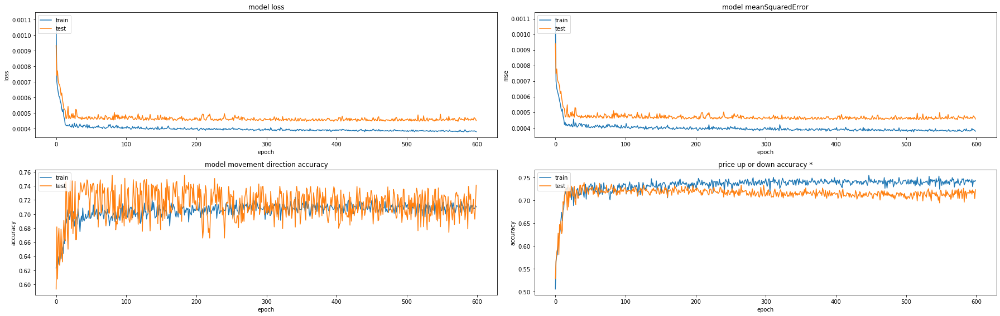

498/498 [==============================] - 2s 5ms/step - loss: 4.6854e-04 - mean_squared_error: 4.6854e-04 - movement_accuracy: 0.7390 - above_or_below_zero_accuracy: 0.7390
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


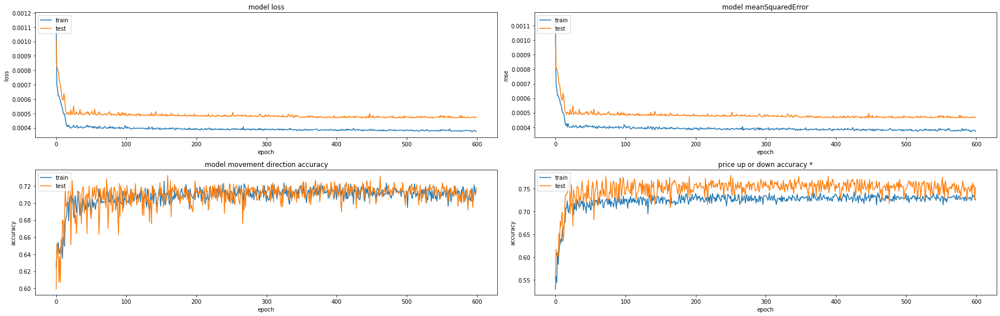

498/498 [==============================] - 2s 5ms/step - loss: 4.7838e-04 - mean_squared_error: 4.7838e-04 - movement_accuracy: 0.7048 - above_or_below_zero_accuracy: 0.7811
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


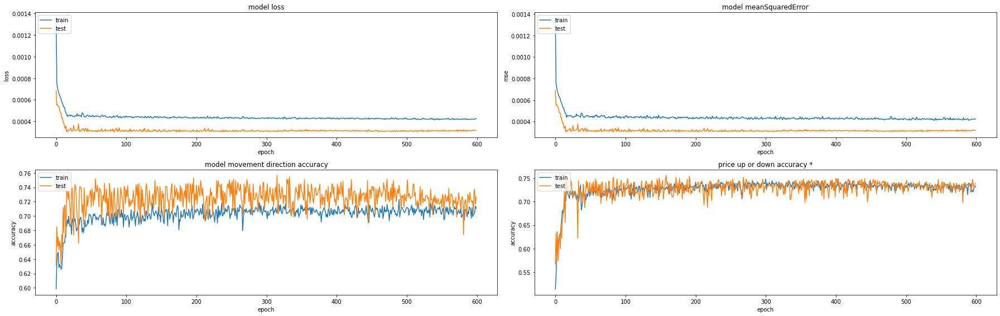

497/497 [==============================] - 3s 5ms/step - loss: 3.0670e-04 - mean_squared_error: 3.0670e-04 - movement_accuracy: 0.7425 - above_or_below_zero_accuracy: 0.7545
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


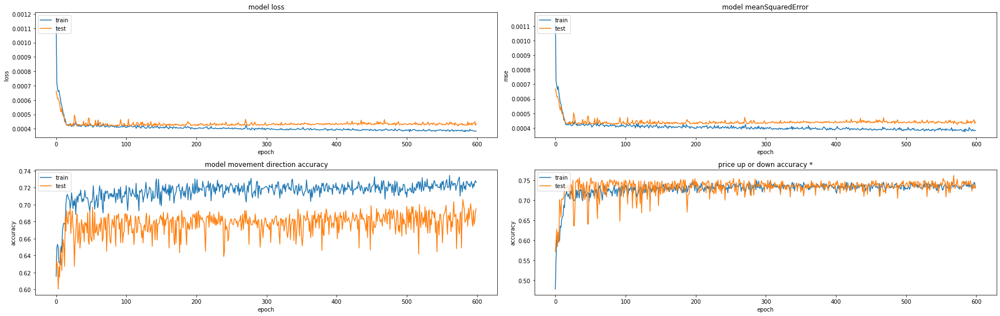

497/497 [==============================] - 2s 5ms/step - loss: 4.2307e-04 - mean_squared_error: 4.2307e-04 - movement_accuracy: 0.6861 - above_or_below_zero_accuracy: 0.7626
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


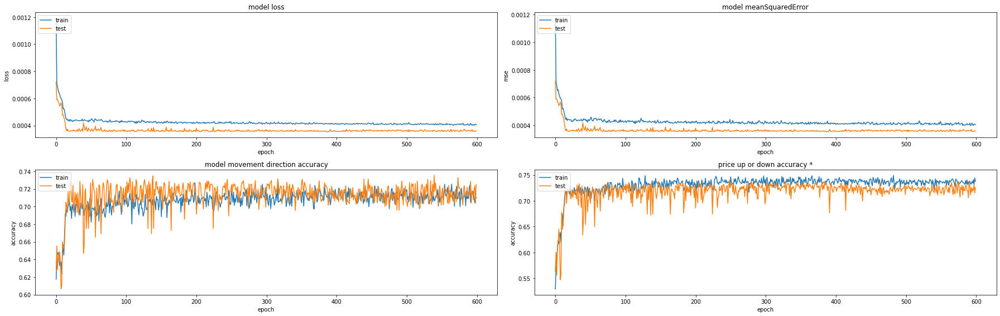

497/497 [==============================] - 3s 5ms/step - loss: 3.5774e-04 - mean_squared_error: 3.5774e-04 - movement_accuracy: 0.7163 - above_or_below_zero_accuracy: 0.7404
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


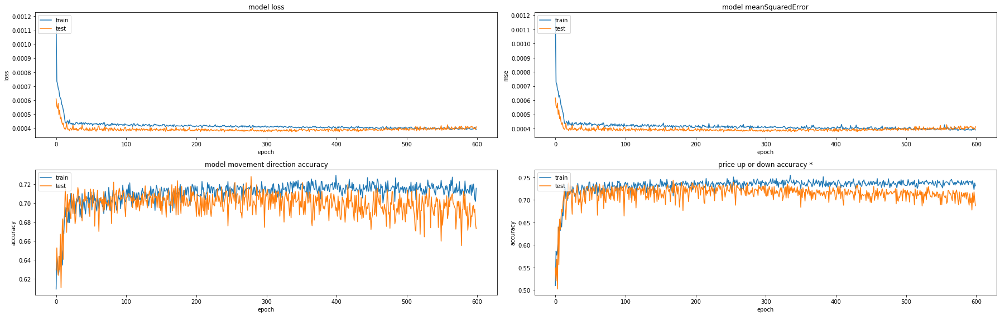

498/498 [==============================] - 3s 5ms/step - loss: 3.7990e-04 - mean_squared_error: 3.7990e-04 - movement_accuracy: 0.7169 - above_or_below_zero_accuracy: 0.7430
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


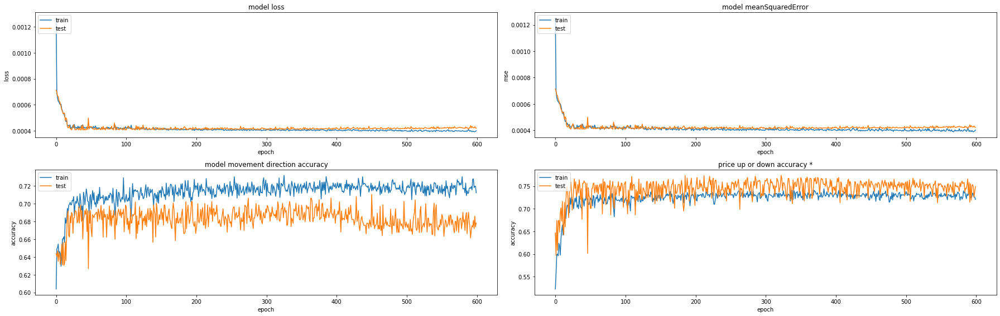

498/498 [==============================] - 3s 5ms/step - loss: 4.1822e-04 - mean_squared_error: 4.1822e-04 - movement_accuracy: 0.6948 - above_or_below_zero_accuracy: 0.7751
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


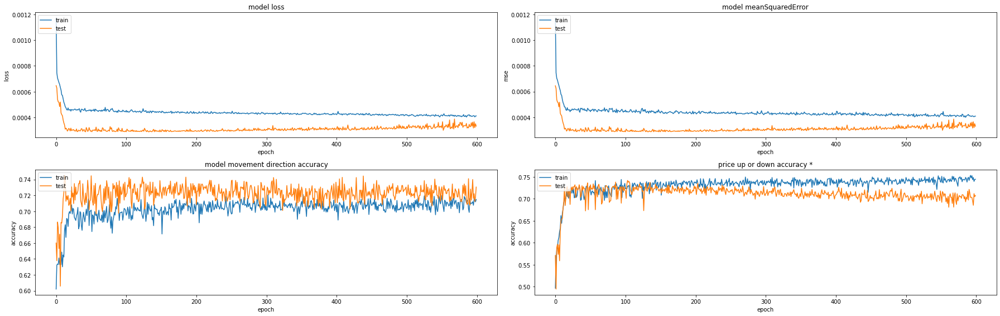

497/497 [==============================] - 3s 5ms/step - loss: 2.9358e-04 - mean_squared_error: 2.9358e-04 - movement_accuracy: 0.7304 - above_or_below_zero_accuracy: 0.7425
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


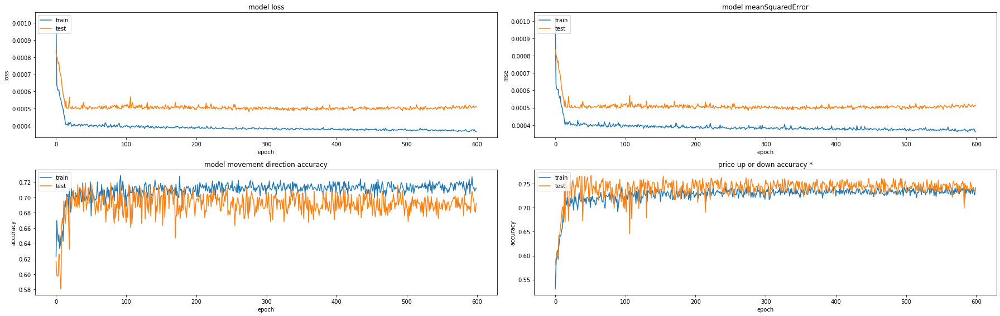

497/497 [==============================] - 3s 5ms/step - loss: 4.9643e-04 - mean_squared_error: 4.9643e-04 - movement_accuracy: 0.7163 - above_or_below_zero_accuracy: 0.7666
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


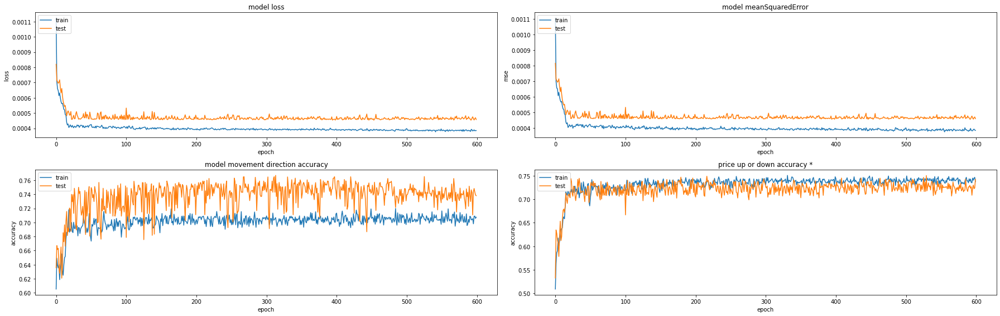

497/497 [==============================] - 3s 5ms/step - loss: 4.5756e-04 - mean_squared_error: 4.5756e-04 - movement_accuracy: 0.7425 - above_or_below_zero_accuracy: 0.7505

Results:

MeanSquaredError: [0.00044478807831183076, 0.0004655616939999163, 0.0003032619133591652, 0.00041795216384343803, 0.0003536400035955012, 0.0003724456182681024, 0.00040442615863867104, 0.0002879957028198987, 0.0004816495638806373, 0.0004529664875008166]
MovementDiretionAccuracy: [0.7550200819969177, 0.7329317331314087, 0.758551299571991, 0.7062374353408813, 0.7344064116477966, 0.7289156913757324, 0.7108433842658997, 0.7444667816162109, 0.7183098793029785, 0.7665995955467224]
AboveOrBellowAccuracy: [0.7389557957649231, 0.781124472618103, 0.7545271515846252, 0.7625754475593567, 0.7404426336288452, 0.7429718971252441, 0.7751004099845886, 0.7424547076225281, 0.7665995955467224, 0.7505030035972595]

MeanSquaredError mean: 0.00039846873842179774
MovementDiretionAccuracy mean: 0.7356282293796539
AboveOrBellowAccu

In [11]:
features = [variation]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


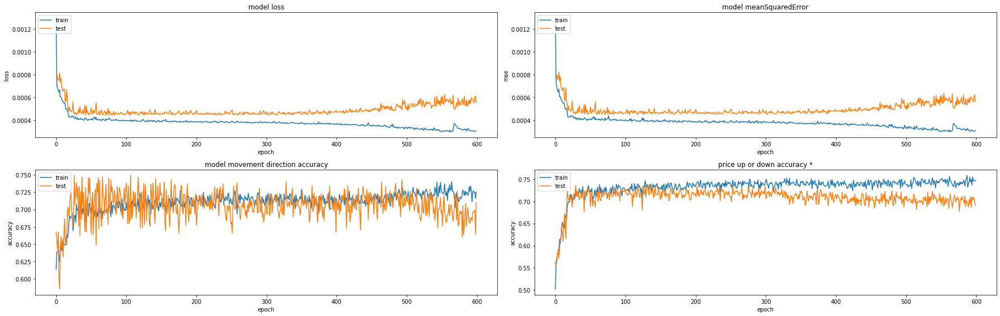

498/498 [==============================] - 2s 5ms/step - loss: 4.5720e-04 - mean_squared_error: 4.5720e-04 - movement_accuracy: 0.7369 - above_or_below_zero_accuracy: 0.7369
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


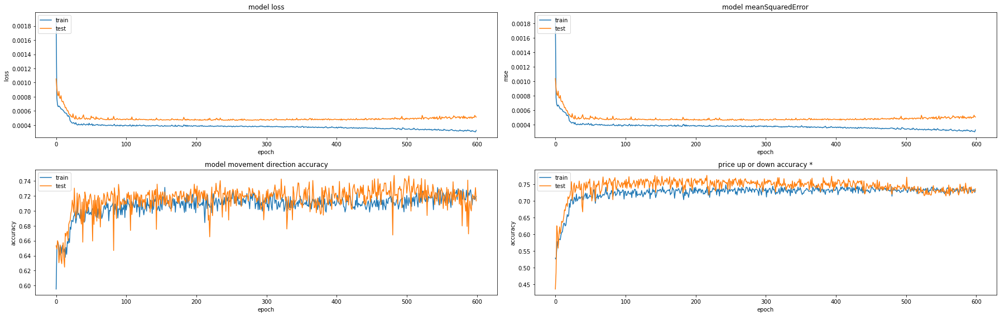

498/498 [==============================] - 2s 5ms/step - loss: 4.6916e-04 - mean_squared_error: 4.6916e-04 - movement_accuracy: 0.7169 - above_or_below_zero_accuracy: 0.7771
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


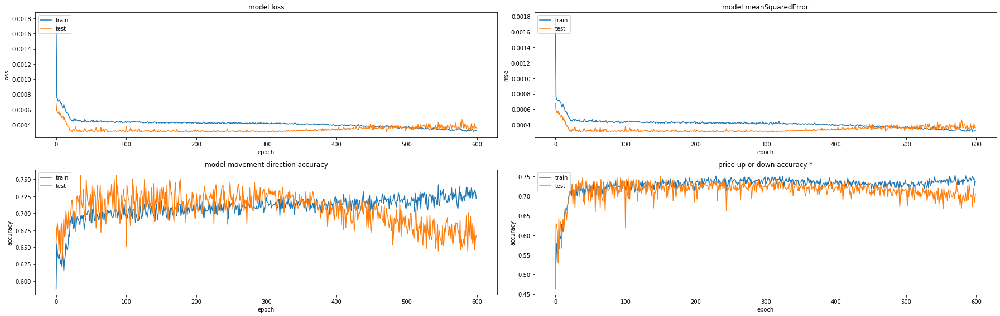

497/497 [==============================] - 3s 5ms/step - loss: 3.1575e-04 - mean_squared_error: 3.1575e-04 - movement_accuracy: 0.7324 - above_or_below_zero_accuracy: 0.7485
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


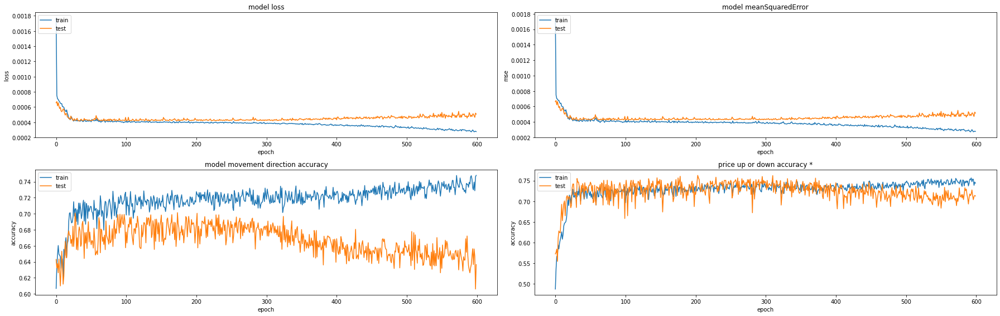

497/497 [==============================] - 3s 5ms/step - loss: 4.2436e-04 - mean_squared_error: 4.2436e-04 - movement_accuracy: 0.6861 - above_or_below_zero_accuracy: 0.7626
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


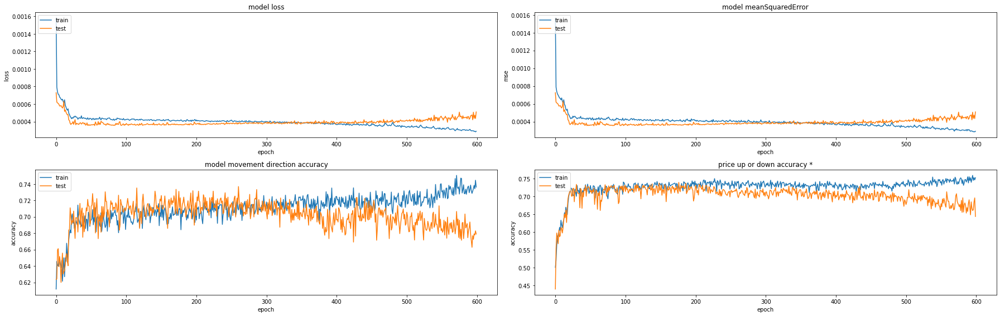

497/497 [==============================] - 3s 5ms/step - loss: 3.6577e-04 - mean_squared_error: 3.6577e-04 - movement_accuracy: 0.7103 - above_or_below_zero_accuracy: 0.7404
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


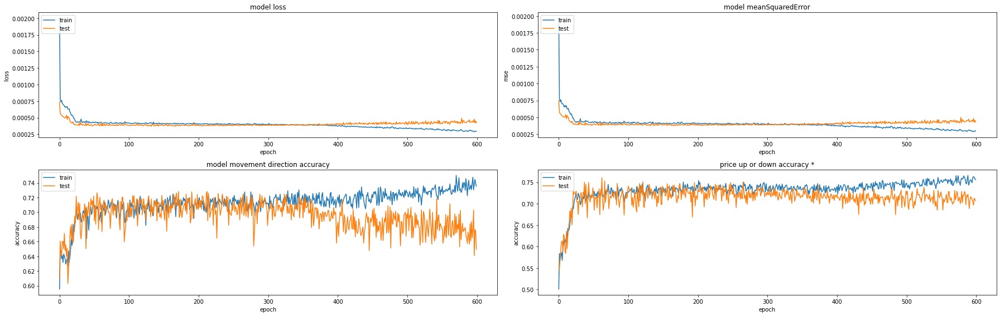

498/498 [==============================] - 3s 5ms/step - loss: 3.7768e-04 - mean_squared_error: 3.7768e-04 - movement_accuracy: 0.7028 - above_or_below_zero_accuracy: 0.7590
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


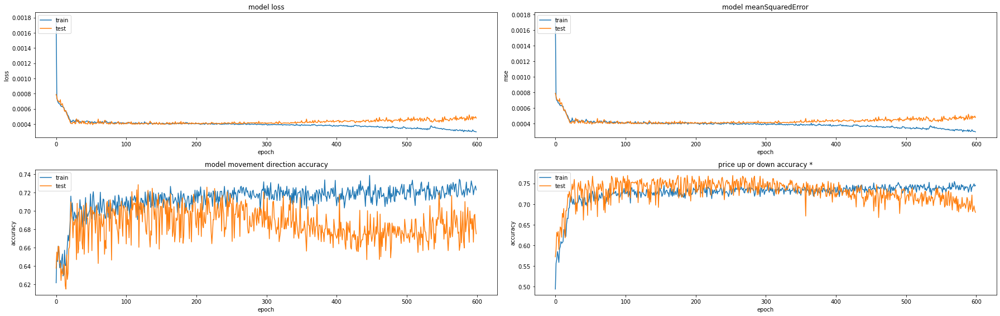

498/498 [==============================] - 3s 5ms/step - loss: 4.0740e-04 - mean_squared_error: 4.0740e-04 - movement_accuracy: 0.7008 - above_or_below_zero_accuracy: 0.7711
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


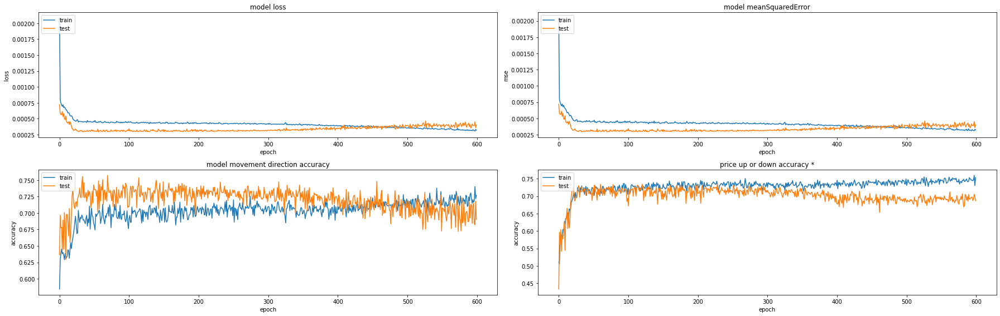

497/497 [==============================] - 3s 5ms/step - loss: 3.0050e-04 - mean_squared_error: 3.0050e-04 - movement_accuracy: 0.7304 - above_or_below_zero_accuracy: 0.7344
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


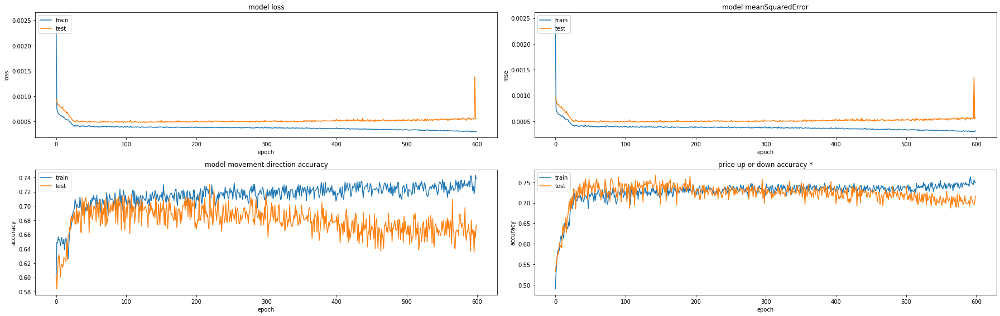

497/497 [==============================] - 3s 5ms/step - loss: 4.9138e-04 - mean_squared_error: 4.9138e-04 - movement_accuracy: 0.7022 - above_or_below_zero_accuracy: 0.7666
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


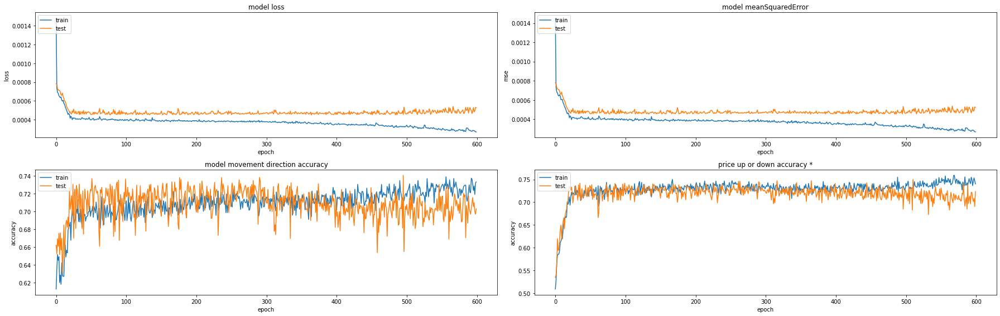

497/497 [==============================] - 2s 5ms/step - loss: 4.8699e-04 - mean_squared_error: 4.8699e-04 - movement_accuracy: 0.6962 - above_or_below_zero_accuracy: 0.7485

Results:

MeanSquaredError: [0.0004432321002241224, 0.0004657826211769134, 0.0003067234647460282, 0.00041728760697878897, 0.00035409556585364044, 0.00037160448846407235, 0.0003909936058335006, 0.00029470358276739717, 0.00048089877236634493, 0.00045097366091795266]
MovementDiretionAccuracy: [0.7489959597587585, 0.7469879388809204, 0.7565392255783081, 0.7022132873535156, 0.7364184856414795, 0.7289156913757324, 0.7289156913757324, 0.7565392255783081, 0.7303823232650757, 0.7404426336288452]
AboveOrBellowAccuracy: [0.736947774887085, 0.7771084308624268, 0.7484909296035767, 0.7625754475593567, 0.7404426336288452, 0.759036123752594, 0.7710843086242676, 0.7344064116477966, 0.7665995955467224, 0.7484909296035767]

MeanSquaredError mean: 0.0003976295469328761
MovementDiretionAccuracy mean: 0.7376350462436676
AboveOrBellowAc

In [12]:
features = [variation, volume_variation]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')

# Agora vamo ver como a adição de variação de volume vai afetar

## Ethereum

In [15]:
base_coin_str = 'ETH'
base_coin_fullname_str = 'ethereum'

df = load_data(base_coin_str, base_coin_fullname_str, event_days_left_lookback=7, storage_folder='../data', events_query=query_str)
variation = df.loc[:, 'price (%)'].to_numpy()
volume_variation = df['Volume'].pct_change().fillna(0).to_numpy()

features_set, _ = to_keras_format([variation], variation)
shuffle_mask = np.arange(len(features_set))
np.random.shuffle(shuffle_mask)

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


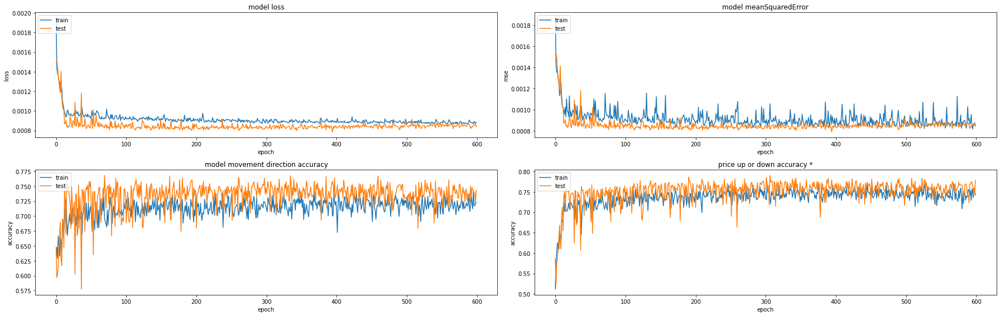

356/356 [==============================] - 2s 5ms/step - loss: 8.1710e-04 - mean_squared_error: 8.1710e-04 - movement_accuracy: 0.7584 - above_or_below_zero_accuracy: 0.7865
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


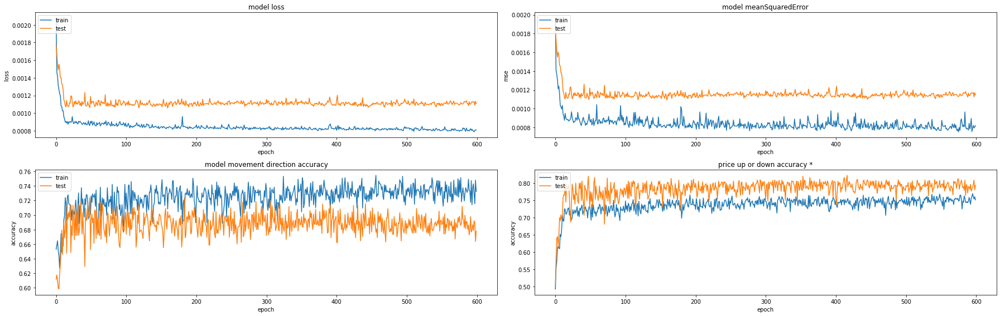

356/356 [==============================] - 2s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7022 - above_or_below_zero_accuracy: 0.8202
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


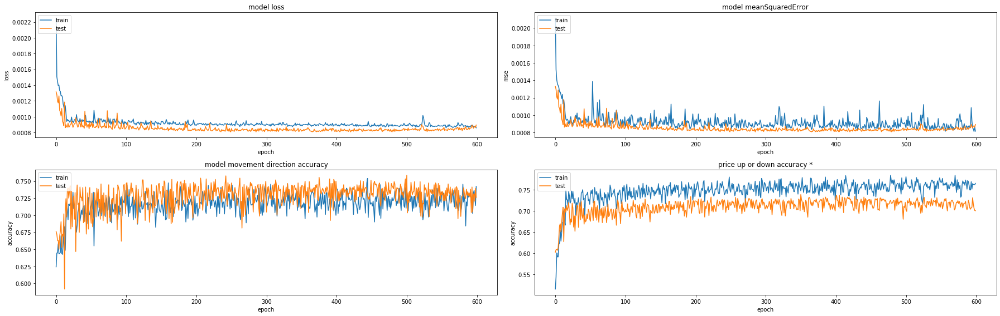

356/356 [==============================] - 2s 6ms/step - loss: 8.1695e-04 - mean_squared_error: 8.1695e-04 - movement_accuracy: 0.7388 - above_or_below_zero_accuracy: 0.7360
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


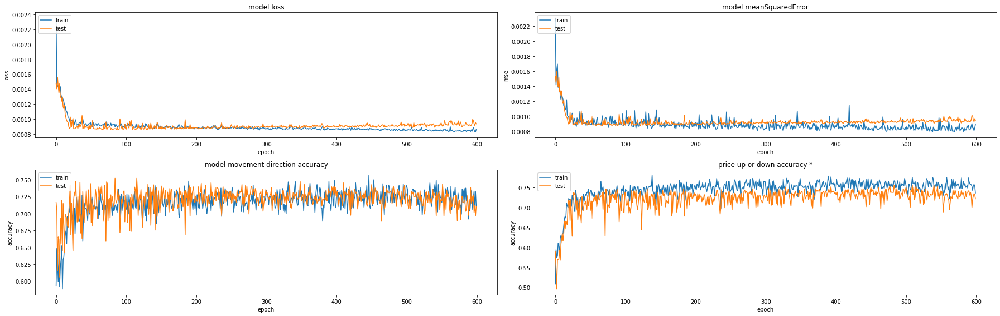

356/356 [==============================] - 2s 6ms/step - loss: 9.0714e-04 - mean_squared_error: 9.0714e-04 - movement_accuracy: 0.7219 - above_or_below_zero_accuracy: 0.7556
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


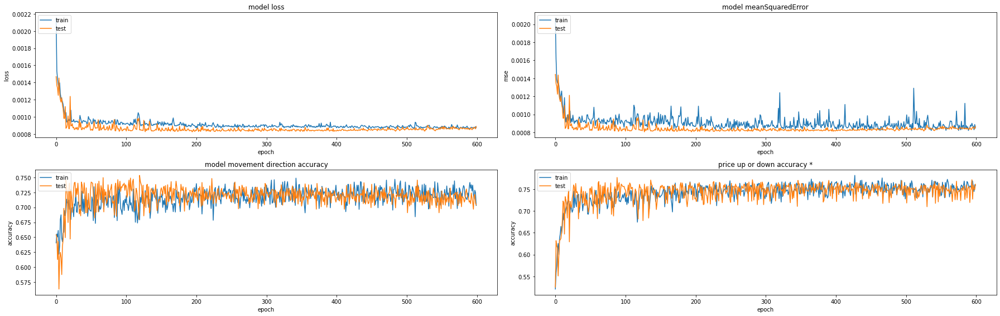

356/356 [==============================] - 2s 6ms/step - loss: 8.5667e-04 - mean_squared_error: 8.5667e-04 - movement_accuracy: 0.7444 - above_or_below_zero_accuracy: 0.7753
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


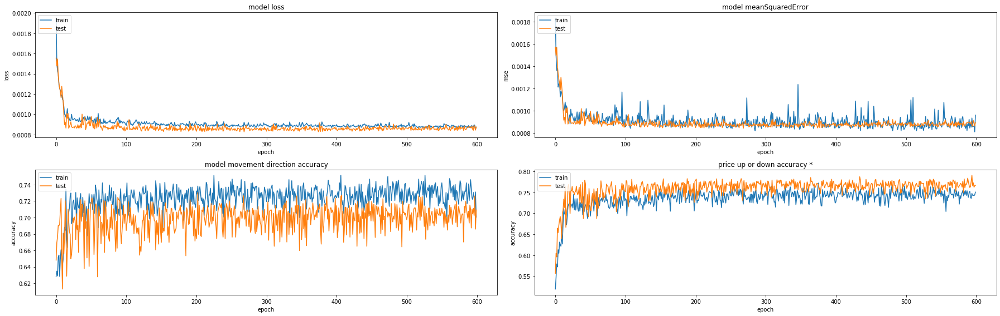

356/356 [==============================] - 2s 6ms/step - loss: 8.5048e-04 - mean_squared_error: 8.5048e-04 - movement_accuracy: 0.7079 - above_or_below_zero_accuracy: 0.7921
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


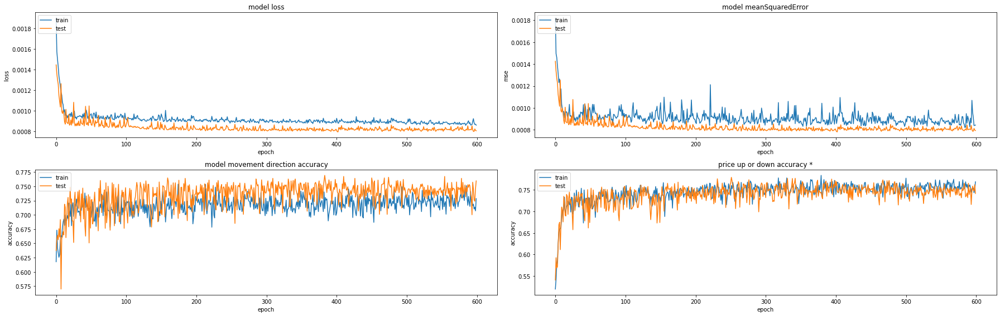

356/356 [==============================] - 2s 6ms/step - loss: 8.1452e-04 - mean_squared_error: 8.1452e-04 - movement_accuracy: 0.7360 - above_or_below_zero_accuracy: 0.7753
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


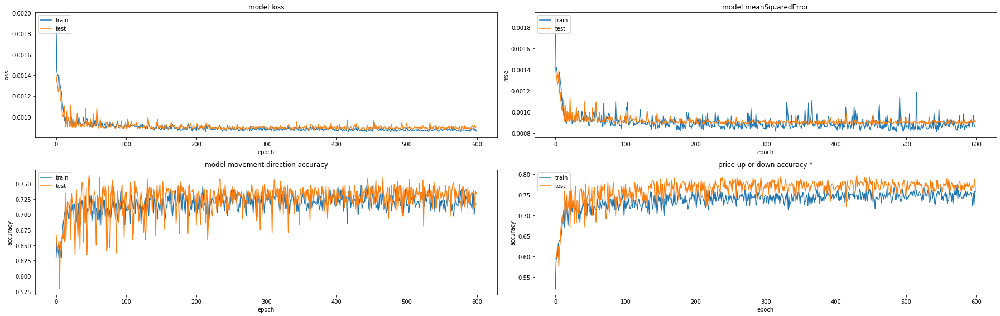

356/356 [==============================] - 2s 5ms/step - loss: 8.8769e-04 - mean_squared_error: 8.8769e-04 - movement_accuracy: 0.7360 - above_or_below_zero_accuracy: 0.7949
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


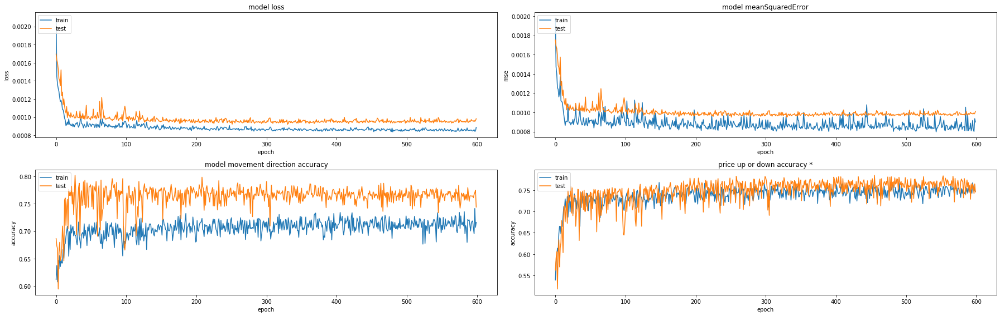

356/356 [==============================] - 2s 6ms/step - loss: 9.3997e-04 - mean_squared_error: 9.3997e-04 - movement_accuracy: 0.7669 - above_or_below_zero_accuracy: 0.7837
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


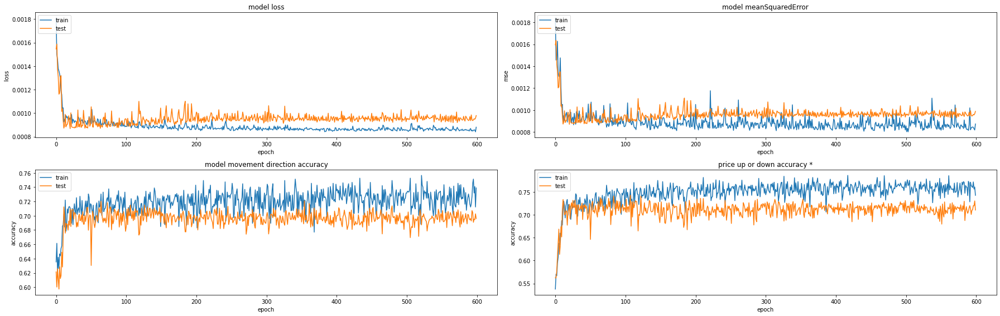

356/356 [==============================] - 2s 5ms/step - loss: 9.1513e-04 - mean_squared_error: 9.1513e-04 - movement_accuracy: 0.6966 - above_or_below_zero_accuracy: 0.7416

Results:

MeanSquaredError: [0.0007869681576266885, 0.0010566766140982509, 0.0008078385726548731, 0.0008603286696597934, 0.0008266380755230784, 0.000827177194878459, 0.0007966745179146528, 0.0008709706016816199, 0.0009214421734213829, 0.0008684786153025925]
MovementDiretionAccuracy: [0.7696629166603088, 0.7219101190567017, 0.7528089880943298, 0.75, 0.7528089880943298, 0.7303370833396912, 0.766853928565979, 0.7640449404716492, 0.800561785697937, 0.716292142868042]
AboveOrBellowAccuracy: [0.7865168452262878, 0.8202247023582458, 0.7359550595283508, 0.7556179761886597, 0.7752808928489685, 0.7921348214149475, 0.7752808928489685, 0.7949438095092773, 0.783707857131958, 0.7415730357170105]

MeanSquaredError mean: 0.0008623193192761391
MovementDiretionAccuracy mean: 0.7525280892848969
AboveOrBellowAccuracy mean: 0.77612358

In [16]:
features = [variation,]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


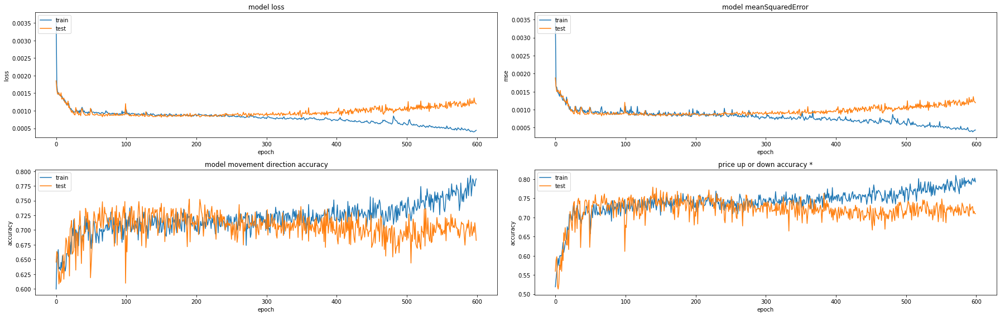

356/356 [==============================] - 2s 5ms/step - loss: 8.3258e-04 - mean_squared_error: 8.3258e-04 - movement_accuracy: 0.7219 - above_or_below_zero_accuracy: 0.7753
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


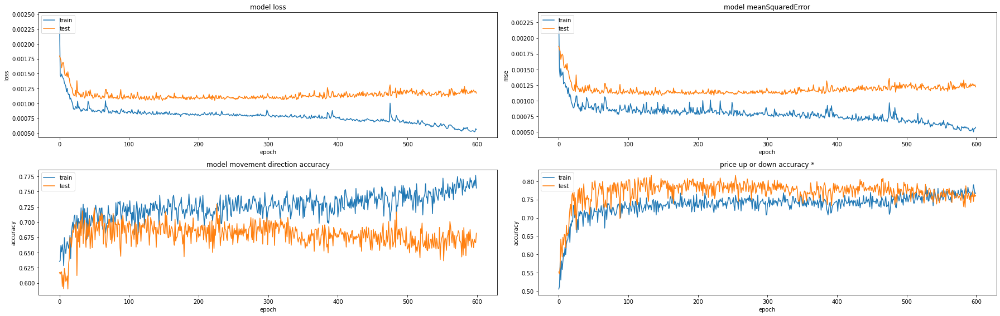

356/356 [==============================] - 2s 5ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.6910 - above_or_below_zero_accuracy: 0.8118
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


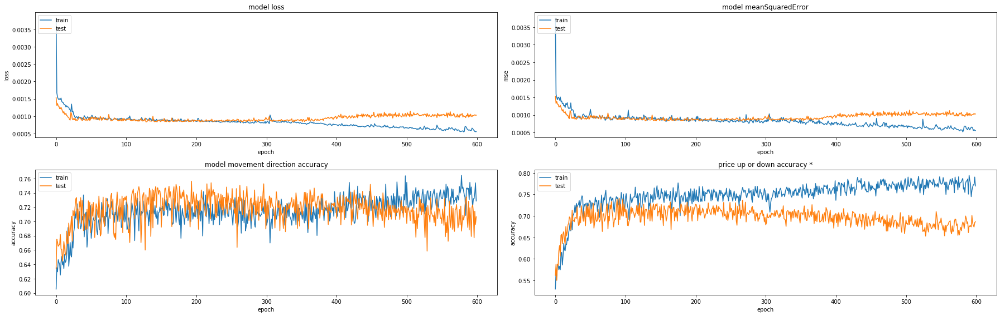

356/356 [==============================] - 2s 5ms/step - loss: 8.7076e-04 - mean_squared_error: 8.7076e-04 - movement_accuracy: 0.7275 - above_or_below_zero_accuracy: 0.7388
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


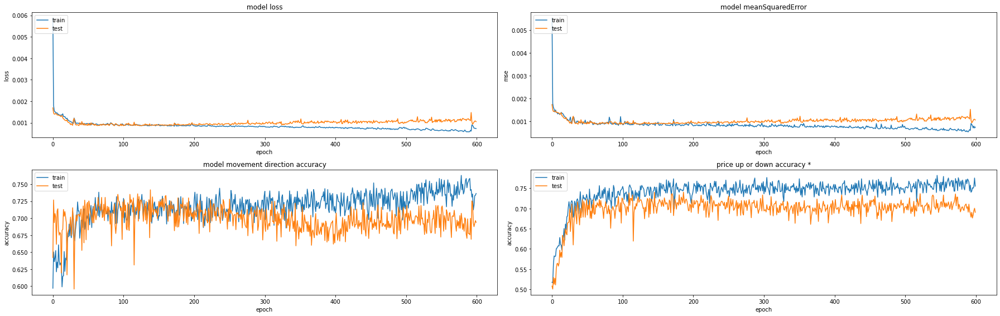

356/356 [==============================] - 2s 6ms/step - loss: 8.8654e-04 - mean_squared_error: 8.8654e-04 - movement_accuracy: 0.7051 - above_or_below_zero_accuracy: 0.7444
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


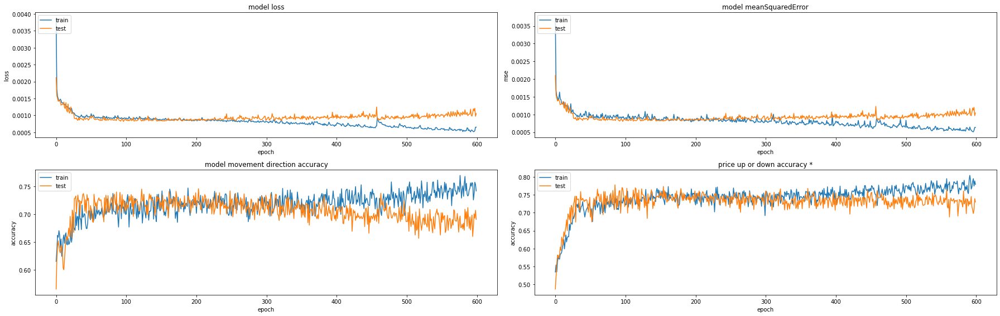

356/356 [==============================] - 2s 5ms/step - loss: 8.5863e-04 - mean_squared_error: 8.5863e-04 - movement_accuracy: 0.7135 - above_or_below_zero_accuracy: 0.7781
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


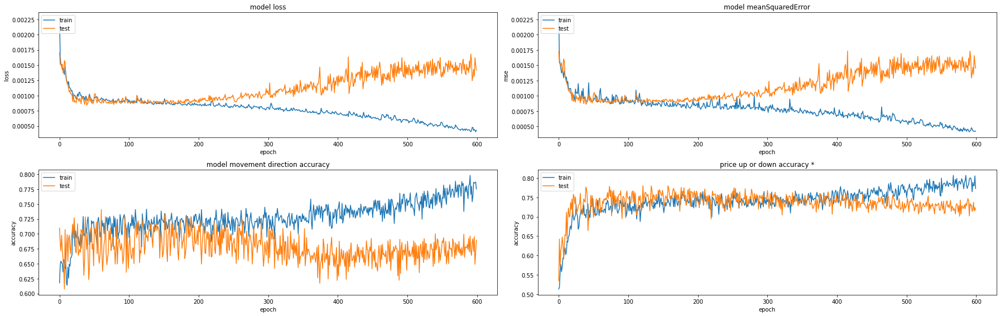

356/356 [==============================] - 2s 5ms/step - loss: 8.6847e-04 - mean_squared_error: 8.6847e-04 - movement_accuracy: 0.7022 - above_or_below_zero_accuracy: 0.7809
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


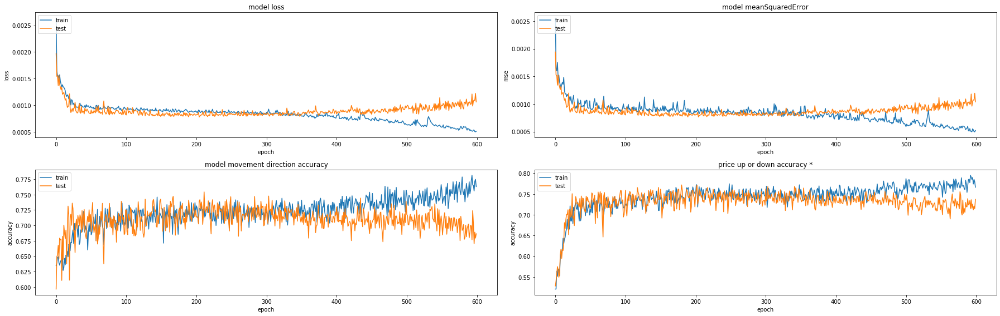

356/356 [==============================] - 2s 6ms/step - loss: 7.9978e-04 - mean_squared_error: 7.9978e-04 - movement_accuracy: 0.7331 - above_or_below_zero_accuracy: 0.7697
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


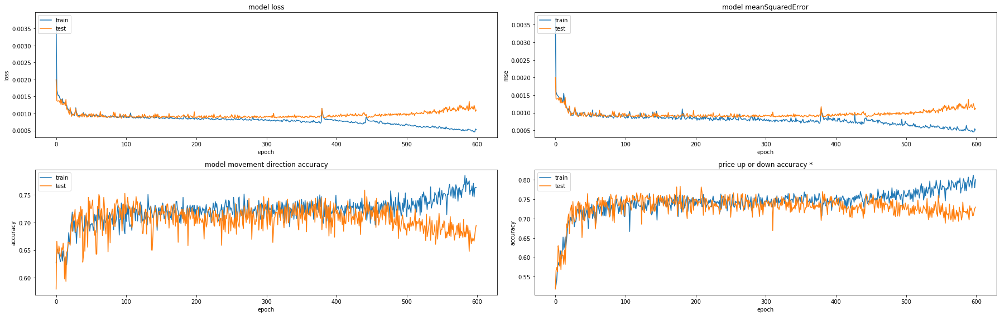

356/356 [==============================] - 2s 5ms/step - loss: 8.8629e-04 - mean_squared_error: 8.8629e-04 - movement_accuracy: 0.7107 - above_or_below_zero_accuracy: 0.7809
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


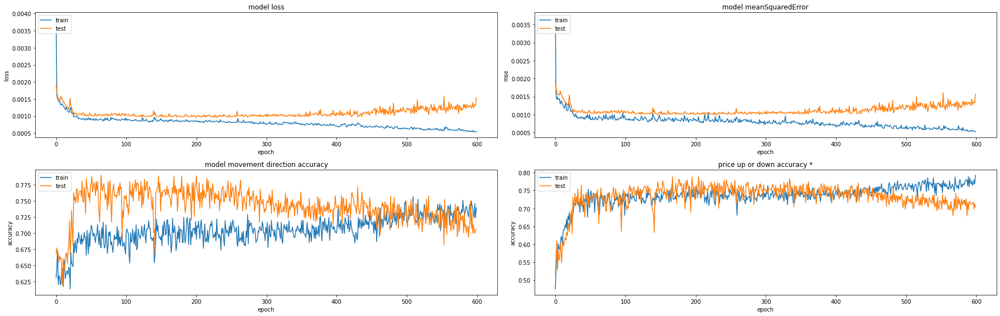

356/356 [==============================] - 2s 5ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.7612 - above_or_below_zero_accuracy: 0.7865    
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


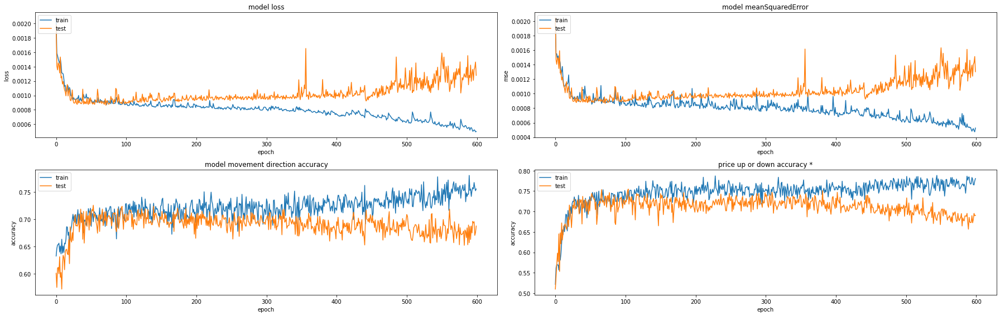

356/356 [==============================] - 2s 5ms/step - loss: 9.2773e-04 - mean_squared_error: 9.2773e-04 - movement_accuracy: 0.7079 - above_or_below_zero_accuracy: 0.7528

Results:

MeanSquaredError: [0.0008132688235491514, 0.0010505940299481153, 0.0008369839051738381, 0.0008617790881544352, 0.0008215029374696314, 0.0008465332794003189, 0.0007773956167511642, 0.0008606344927102327, 0.0009574719588272274, 0.0008627105853520334]
MovementDiretionAccuracy: [0.7528089880943298, 0.7247191071510315, 0.7528089880943298, 0.7387640476226807, 0.7443820238113403, 0.7415730357170105, 0.75, 0.7584269642829895, 0.7865168452262878, 0.7219101190567017]
AboveOrBellowAccuracy: [0.7752808928489685, 0.8117977380752563, 0.7387640476226807, 0.7443820238113403, 0.7780898809432983, 0.7808988690376282, 0.7696629166603088, 0.7808988690376282, 0.7865168452262878, 0.7528089880943298]

MeanSquaredError mean: 0.0008688874717336148
MovementDiretionAccuracy mean: 0.7471910119056702
AboveOrBellowAccuracy mean: 0.771

In [17]:
features = [variation, volume_variation]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')

## Tron

In [18]:
base_coin_str = 'TRX'
base_coin_fullname_str = 'tron'

df = load_data(base_coin_str, base_coin_fullname_str, event_days_left_lookback=7, storage_folder='../data', events_query=query_str)
variation = df.loc[:, 'price (%)'].to_numpy()
volume_variation = df['Volume'].pct_change().fillna(0).to_numpy()

features_set, _ = to_keras_format([variation], variation)
shuffle_mask = np.arange(len(features_set))
np.random.shuffle(shuffle_mask)

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


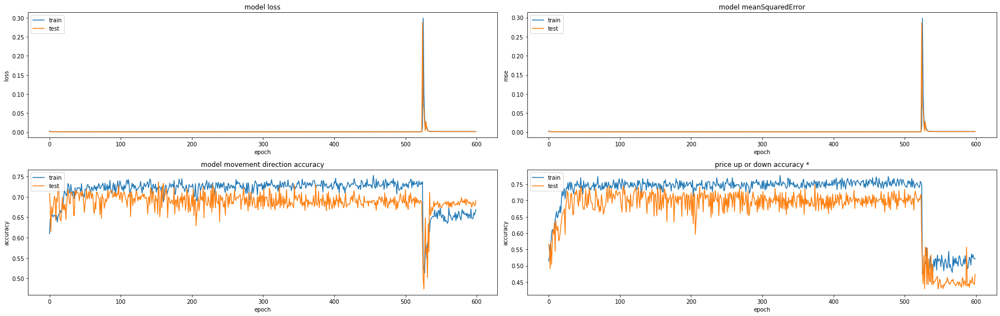

224/224 [==============================] - 1s 4ms/step - loss: 9.1136e-04 - mean_squared_error: 9.1136e-04 - movement_accuracy: 0.7188 - above_or_below_zero_accuracy: 0.7545
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


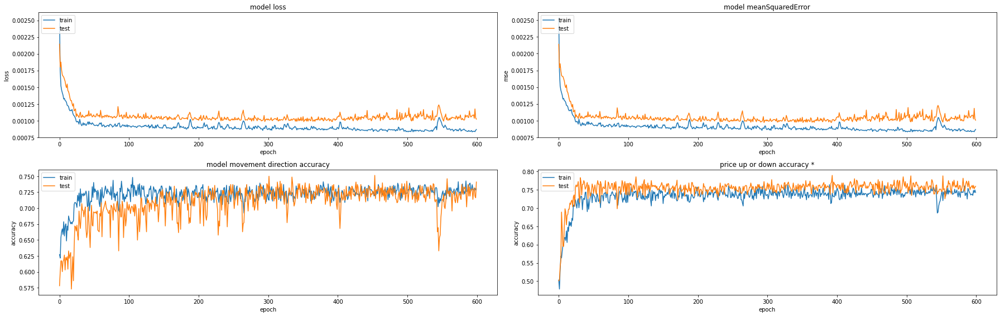

224/224 [==============================] - 1s 5ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.7321 - above_or_below_zero_accuracy: 0.7902
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


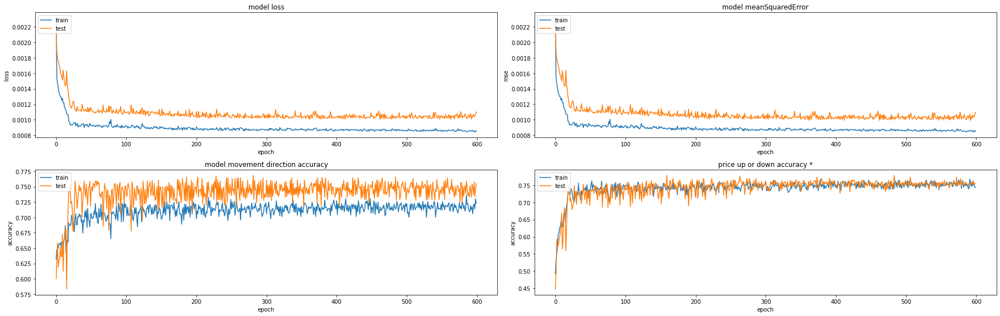

223/223 [==============================] - 1s 5ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7489 - above_or_below_zero_accuracy: 0.7803
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


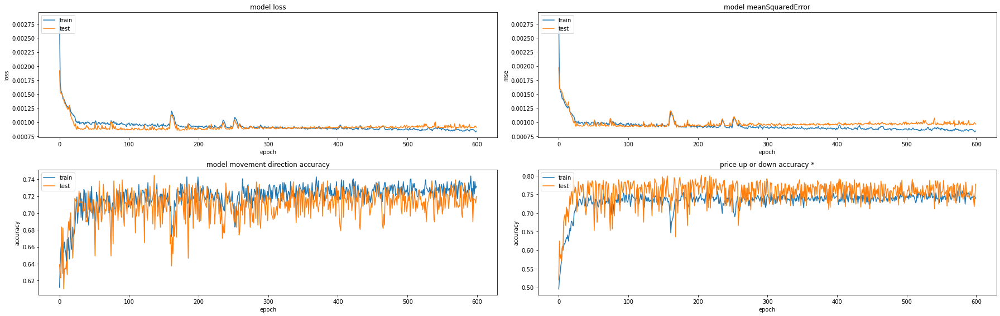

223/223 [==============================] - 1s 5ms/step - loss: 8.7408e-04 - mean_squared_error: 8.7408e-04 - movement_accuracy: 0.7265 - above_or_below_zero_accuracy: 0.8027
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


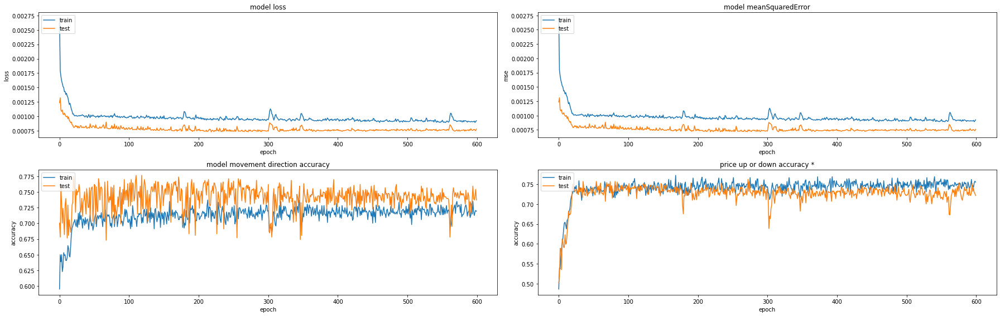

223/223 [==============================] - 1s 5ms/step - loss: 7.6290e-04 - mean_squared_error: 7.6290e-04 - movement_accuracy: 0.7489 - above_or_below_zero_accuracy: 0.7578
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


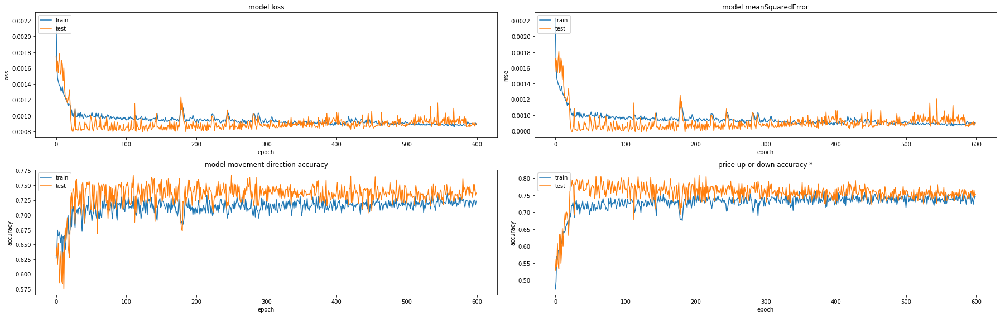

224/224 [==============================] - 1s 5ms/step - loss: 8.4099e-04 - mean_squared_error: 8.4099e-04 - movement_accuracy: 0.7143 - above_or_below_zero_accuracy: 0.8125
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


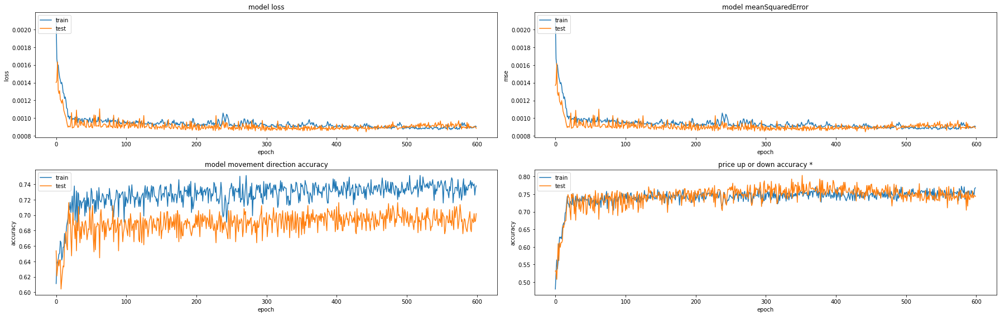

224/224 [==============================] - 1s 5ms/step - loss: 8.5638e-04 - mean_squared_error: 8.5638e-04 - movement_accuracy: 0.6830 - above_or_below_zero_accuracy: 0.7991
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


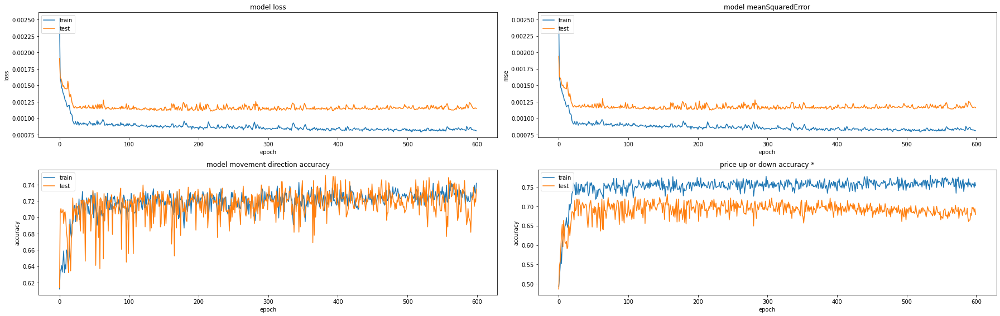

223/223 [==============================] - 1s 5ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7220 - above_or_below_zero_accuracy: 0.7309
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


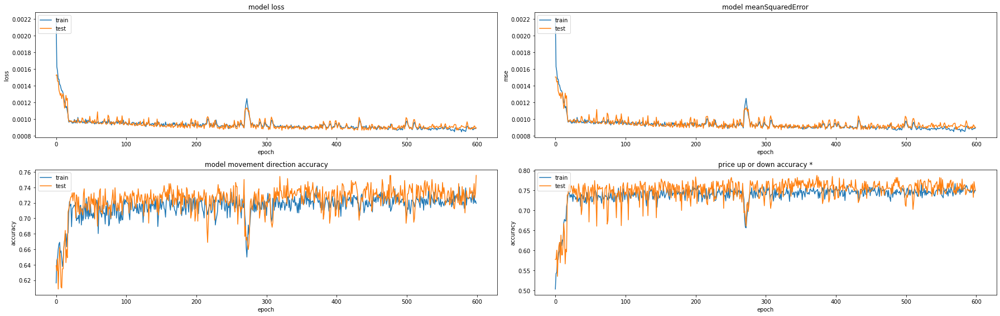

223/223 [==============================] - 1s 5ms/step - loss: 9.0668e-04 - mean_squared_error: 9.0668e-04 - movement_accuracy: 0.7265 - above_or_below_zero_accuracy: 0.7892
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


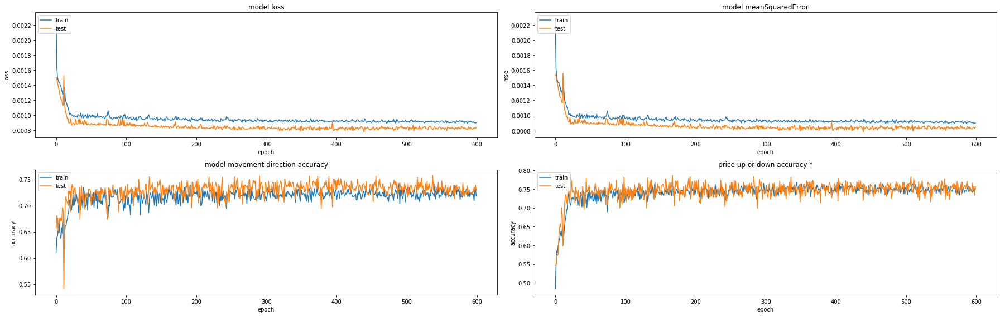

223/223 [==============================] - 1s 5ms/step - loss: 8.3626e-04 - mean_squared_error: 8.3626e-04 - movement_accuracy: 0.7399 - above_or_below_zero_accuracy: 0.7892

Results:

MeanSquaredError: [0.0008562078583054245, 0.0009853154188022017, 0.001008489285595715, 0.0008541882270947099, 0.0007299763383343816, 0.0007957375491969287, 0.0008458771044388413, 0.0011094582732766867, 0.0008652498945593834, 0.0007782683242112398]
MovementDiretionAccuracy: [0.7276785969734192, 0.75, 0.7668161392211914, 0.7488788962364197, 0.7713004350662231, 0.7633928656578064, 0.71875, 0.7533632516860962, 0.7488788962364197, 0.7578475475311279]
AboveOrBellowAccuracy: [0.7544642686843872, 0.7901785969734192, 0.7802690863609314, 0.8026905655860901, 0.7578475475311279, 0.8125, 0.7991071343421936, 0.7309417128562927, 0.7892376780509949, 0.7892376780509949]

MeanSquaredError mean: 0.0008828768273815513
MovementDiretionAccuracy mean: 0.7506906628608704
AboveOrBellowAccuracy mean: 0.7806474268436432

MeanSquar

In [19]:
features = [variation,]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


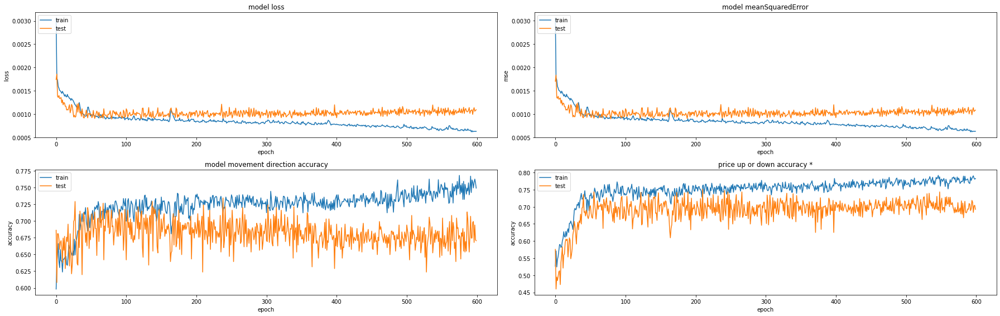

224/224 [==============================] - 1s 5ms/step - loss: 9.3581e-04 - mean_squared_error: 9.3581e-04 - movement_accuracy: 0.7143 - above_or_below_zero_accuracy: 0.7545
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


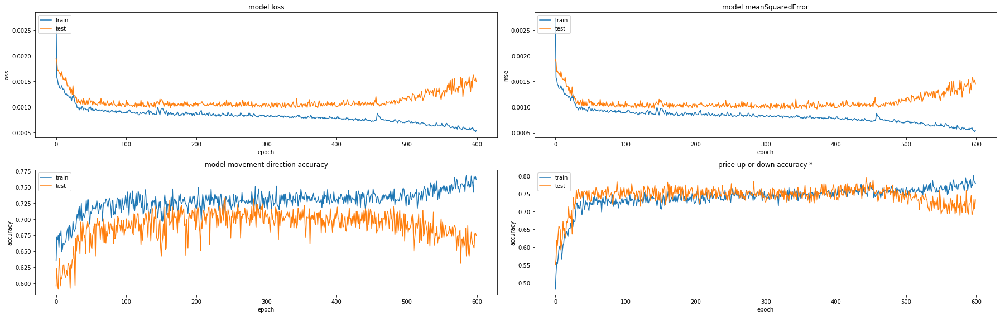

224/224 [==============================] - 1s 5ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.6830 - above_or_below_zero_accuracy: 0.7991
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


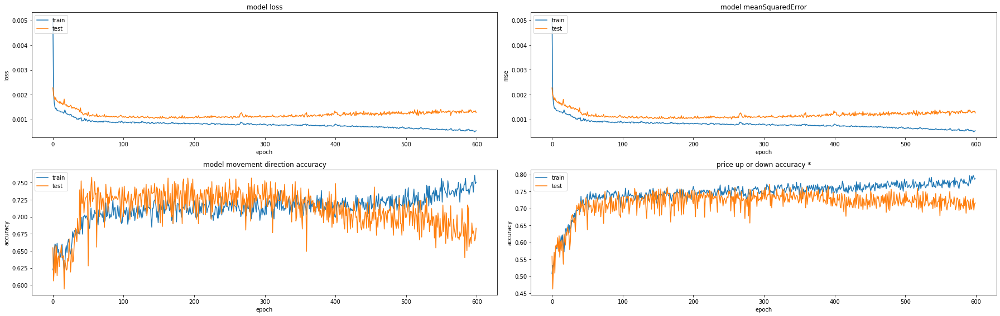

223/223 [==============================] - 1s 5ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7489 - above_or_below_zero_accuracy: 0.7713
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


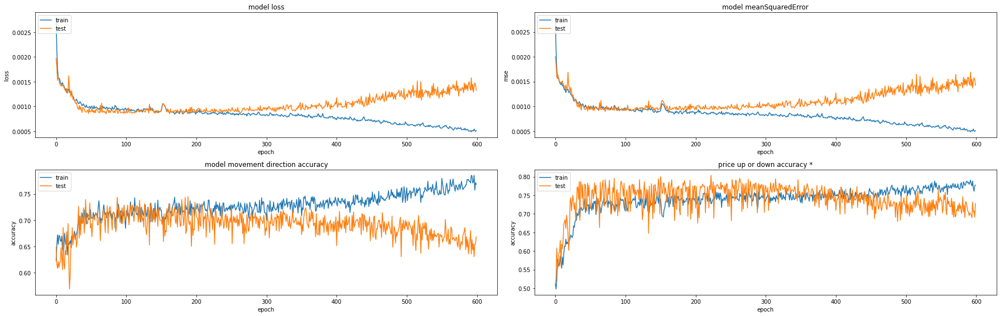

223/223 [==============================] - 1s 5ms/step - loss: 9.1374e-04 - mean_squared_error: 9.1374e-04 - movement_accuracy: 0.7130 - above_or_below_zero_accuracy: 0.8072
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


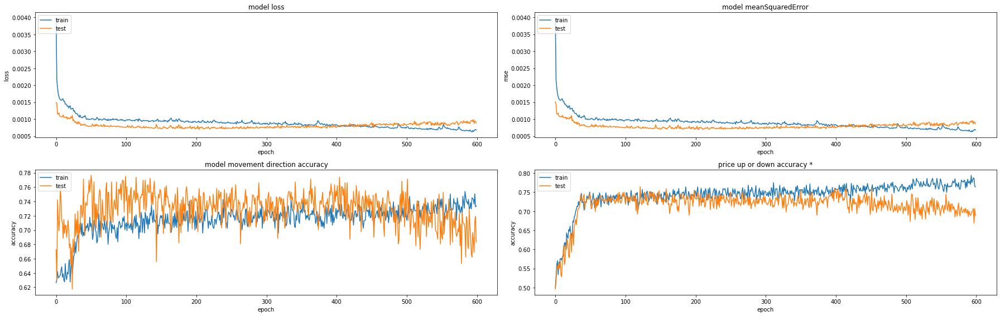

223/223 [==============================] - 1s 5ms/step - loss: 7.5538e-04 - mean_squared_error: 7.5538e-04 - movement_accuracy: 0.7399 - above_or_below_zero_accuracy: 0.7668
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


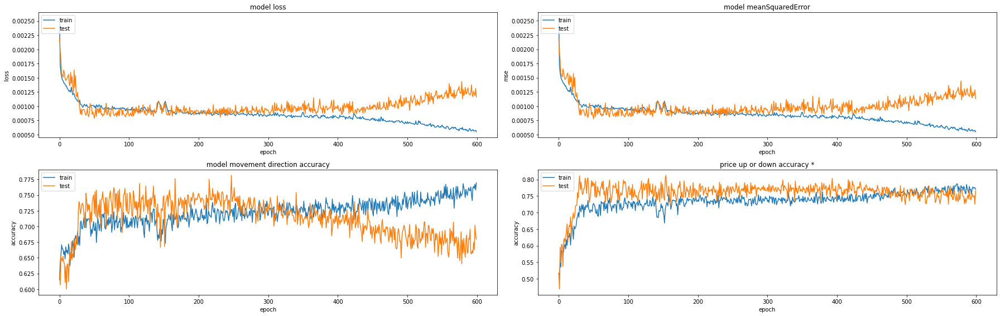

224/224 [==============================] - 1s 6ms/step - loss: 8.5538e-04 - mean_squared_error: 8.5538e-04 - movement_accuracy: 0.7411 - above_or_below_zero_accuracy: 0.8170
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


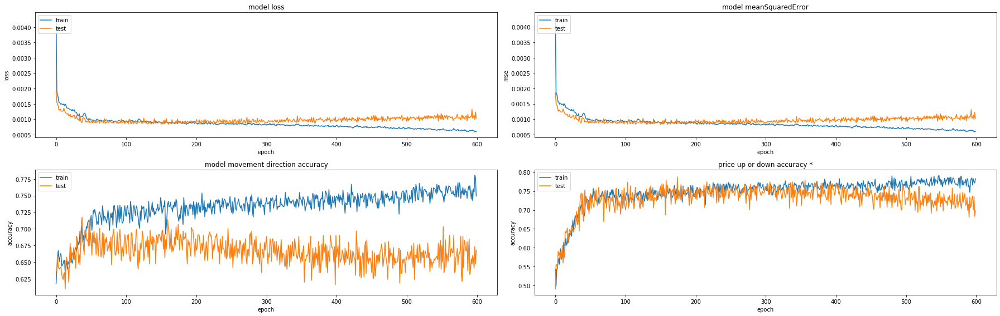

224/224 [==============================] - 1s 5ms/step - loss: 8.8611e-04 - mean_squared_error: 8.8611e-04 - movement_accuracy: 0.7054 - above_or_below_zero_accuracy: 0.7857
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


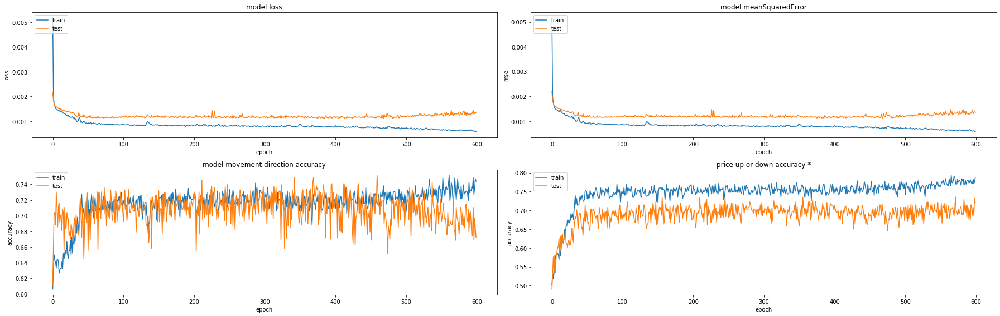

223/223 [==============================] - 1s 6ms/step - loss: 0.0013 - mean_squared_error: 0.0013 - movement_accuracy: 0.7130 - above_or_below_zero_accuracy: 0.7354
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


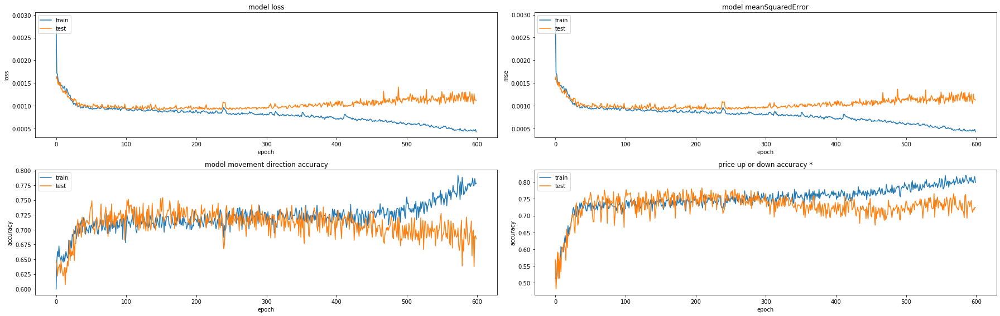

223/223 [==============================] - 1s 6ms/step - loss: 9.2559e-04 - mean_squared_error: 9.2559e-04 - movement_accuracy: 0.7265 - above_or_below_zero_accuracy: 0.7803
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


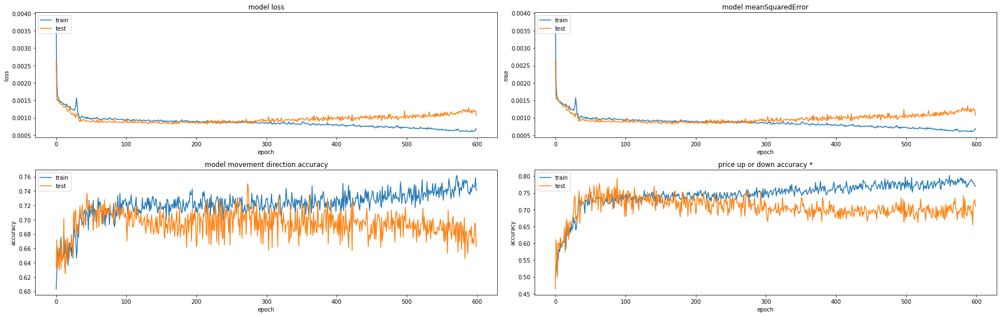

223/223 [==============================] - 1s 5ms/step - loss: 8.7077e-04 - mean_squared_error: 8.7077e-04 - movement_accuracy: 0.7130 - above_or_below_zero_accuracy: 0.7937

Results:

MeanSquaredError: [0.0008927224553190172, 0.0009764427086338401, 0.0010341290617361665, 0.0008488139137625694, 0.0006976618315093219, 0.0007854670402593911, 0.0008378057391382754, 0.0011123096337541938, 0.0009021881851367652, 0.0008088101167231798]
MovementDiretionAccuracy: [0.7232142686843872, 0.7321428656578064, 0.7533632516860962, 0.7488788962364197, 0.7713004350662231, 0.7767857313156128, 0.71875, 0.7488788962364197, 0.7488788962364197, 0.7488788962364197]
AboveOrBellowAccuracy: [0.7544642686843872, 0.7991071343421936, 0.7713004350662231, 0.8071748614311218, 0.7668161392211914, 0.8169642686843872, 0.7857142686843872, 0.7354260087013245, 0.7802690863609314, 0.7937219738960266]

MeanSquaredError mean: 0.000889635068597272
MovementDiretionAccuracy mean: 0.7471072137355804
AboveOrBellowAccuracy mean: 0.7

In [20]:
features = [variation, volume_variation]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')

## EOS

In [21]:
base_coin_str = 'EOS'
base_coin_fullname_str = 'EOS'

df = load_data(base_coin_str, base_coin_fullname_str, event_days_left_lookback=7, storage_folder='../data', events_query=query_str)
variation = df.loc[:, 'price (%)'].to_numpy()
volume_variation = df['Volume'].pct_change().fillna(0).to_numpy()

features_set, _ = to_keras_format([variation], variation)
shuffle_mask = np.arange(len(features_set))
np.random.shuffle(shuffle_mask)

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


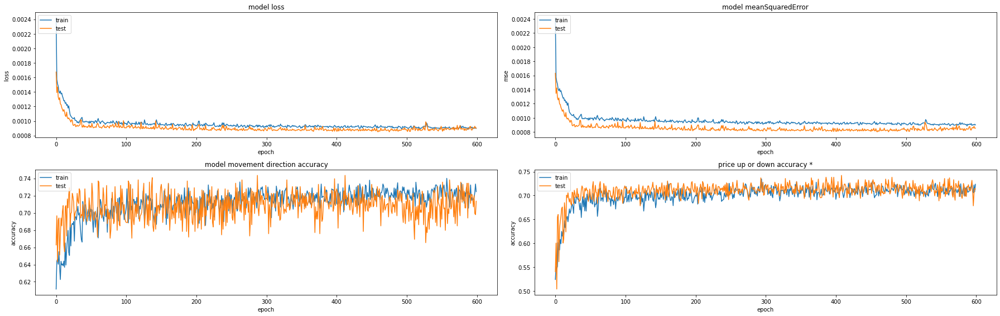

224/224 [==============================] - 1s 5ms/step - loss: 8.6547e-04 - mean_squared_error: 8.6547e-04 - movement_accuracy: 0.7054 - above_or_below_zero_accuracy: 0.7411
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


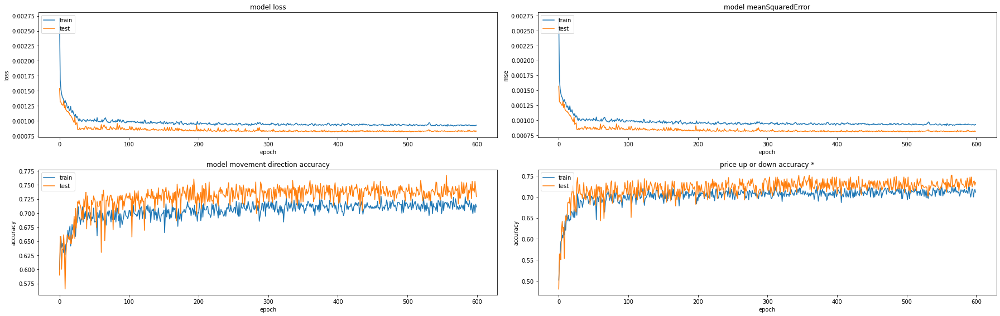

224/224 [==============================] - 1s 5ms/step - loss: 8.2694e-04 - mean_squared_error: 8.2694e-04 - movement_accuracy: 0.7545 - above_or_below_zero_accuracy: 0.7455
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


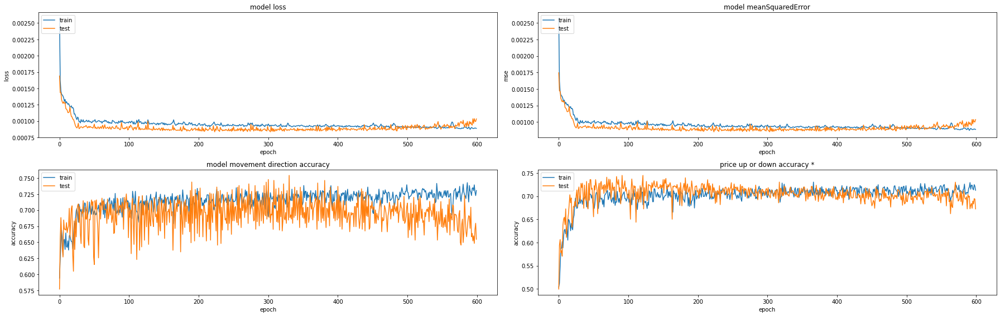

223/223 [==============================] - 1s 6ms/step - loss: 8.8594e-04 - mean_squared_error: 8.8594e-04 - movement_accuracy: 0.7085 - above_or_below_zero_accuracy: 0.7444
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


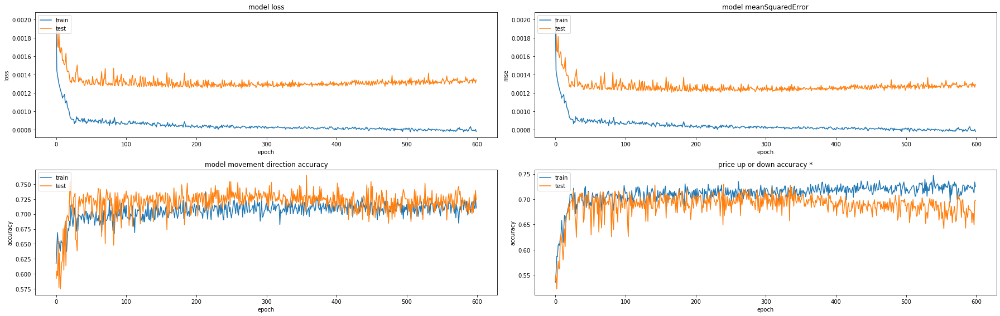

223/223 [==============================] - 1s 6ms/step - loss: 0.0013 - mean_squared_error: 0.0013 - movement_accuracy: 0.7130 - above_or_below_zero_accuracy: 0.7220
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


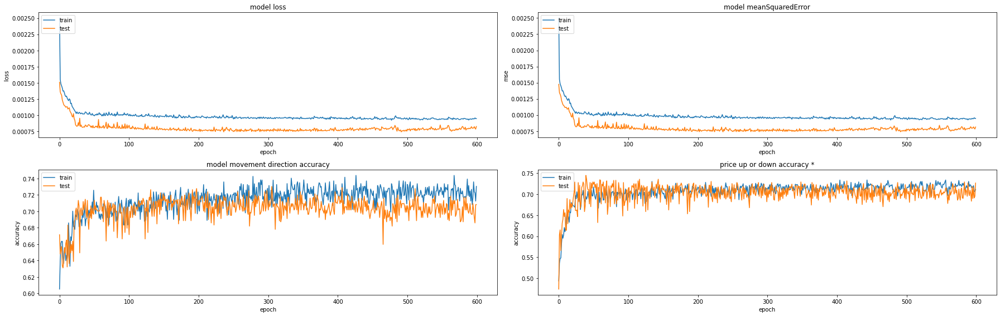

223/223 [==============================] - 1s 5ms/step - loss: 8.2268e-04 - mean_squared_error: 8.2268e-04 - movement_accuracy: 0.6906 - above_or_below_zero_accuracy: 0.7444
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


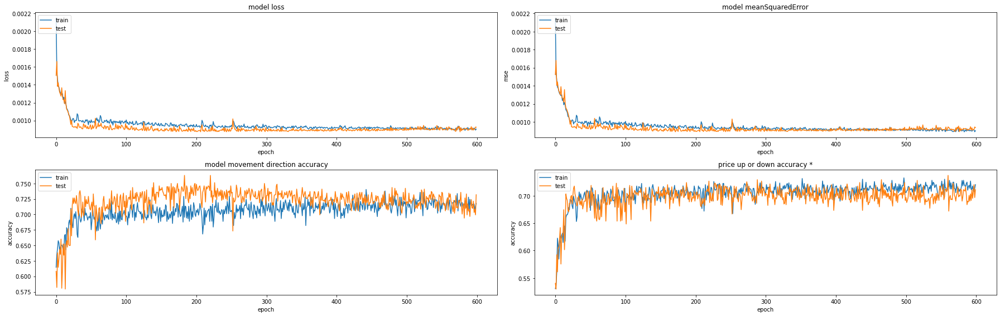

224/224 [==============================] - 1s 5ms/step - loss: 9.2923e-04 - mean_squared_error: 9.2923e-04 - movement_accuracy: 0.7366 - above_or_below_zero_accuracy: 0.7366
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


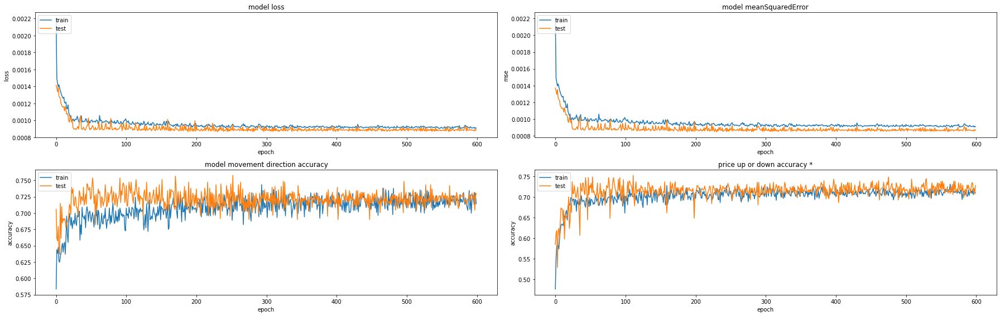

224/224 [==============================] - 1s 5ms/step - loss: 9.0265e-04 - mean_squared_error: 9.0265e-04 - movement_accuracy: 0.7277 - above_or_below_zero_accuracy: 0.7500
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


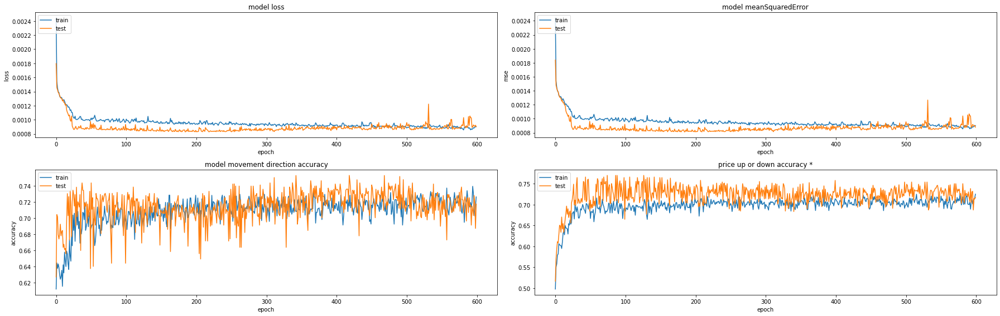

223/223 [==============================] - 1s 5ms/step - loss: 8.5803e-04 - mean_squared_error: 8.5803e-04 - movement_accuracy: 0.7175 - above_or_below_zero_accuracy: 0.7623
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


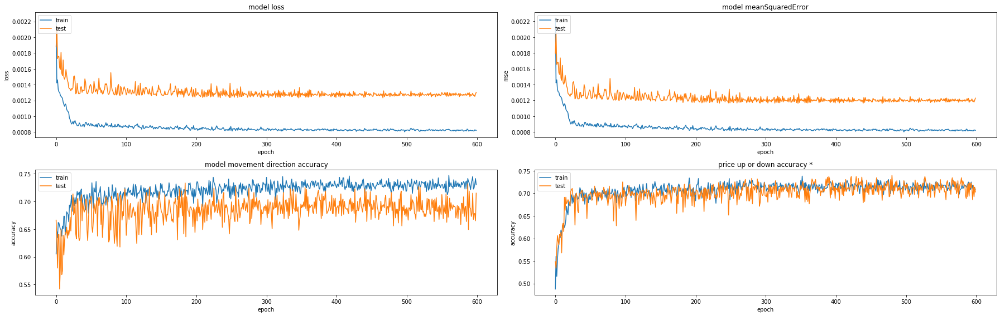

223/223 [==============================] - 1s 5ms/step - loss: 0.0013 - mean_squared_error: 0.0013 - movement_accuracy: 0.6906 - above_or_below_zero_accuracy: 0.7354
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


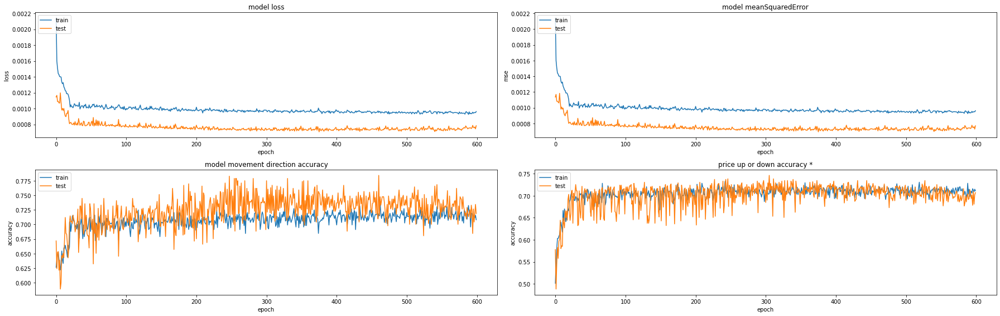

223/223 [==============================] - 1s 5ms/step - loss: 7.3668e-04 - mean_squared_error: 7.3668e-04 - movement_accuracy: 0.7175 - above_or_below_zero_accuracy: 0.7444

Results:

MeanSquaredError: [0.0008510508923791349, 0.0008169460343196988, 0.0008357255719602108, 0.001250659697689116, 0.0007417917368002236, 0.0008735316805541515, 0.000864290283061564, 0.0008314595324918628, 0.0012327957665547729, 0.0007054066518321633]
MovementDiretionAccuracy: [0.7366071343421936, 0.7723214030265808, 0.7488788962364197, 0.7623318433761597, 0.7309417128562927, 0.7633928656578064, 0.7544642686843872, 0.7488788962364197, 0.7219731211662292, 0.7802690863609314]
AboveOrBellowAccuracy: [0.7410714030265808, 0.7455357313156128, 0.7443946003913879, 0.7219731211662292, 0.7443946003913879, 0.7366071343421936, 0.75, 0.7623318433761597, 0.7354260087013245, 0.7443946003913879]

MeanSquaredError mean: 0.0009003657847642899
MovementDiretionAccuracy mean: 0.7520059227943421
AboveOrBellowAccuracy mean: 0.74261

In [22]:
features = [variation,]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


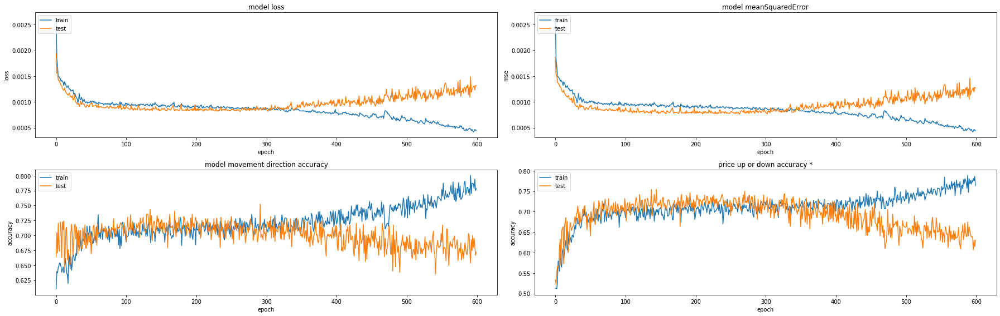

224/224 [==============================] - 1s 5ms/step - loss: 8.2233e-04 - mean_squared_error: 8.2233e-04 - movement_accuracy: 0.6875 - above_or_below_zero_accuracy: 0.7545
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


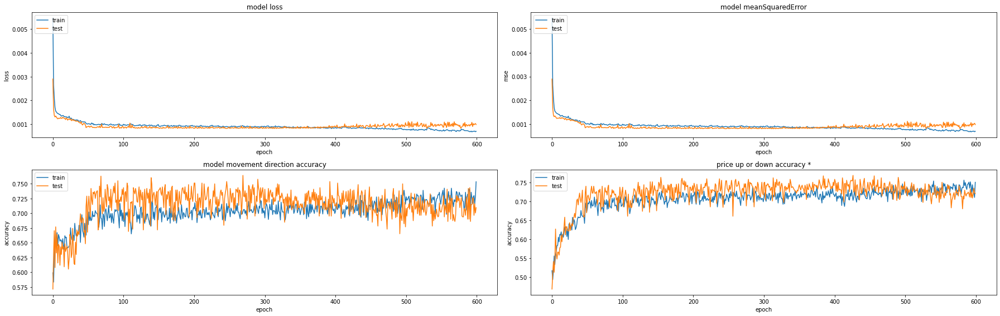

224/224 [==============================] - 1s 5ms/step - loss: 8.8521e-04 - mean_squared_error: 8.8521e-04 - movement_accuracy: 0.7455 - above_or_below_zero_accuracy: 0.7634
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


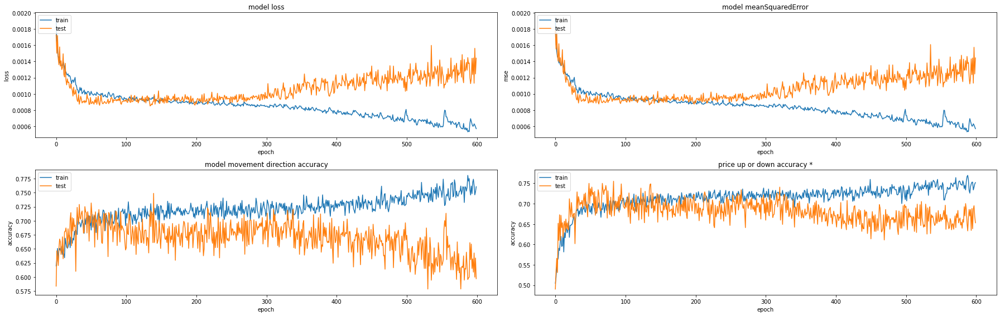

223/223 [==============================] - 1s 5ms/step - loss: 9.1864e-04 - mean_squared_error: 9.1864e-04 - movement_accuracy: 0.6906 - above_or_below_zero_accuracy: 0.7578
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


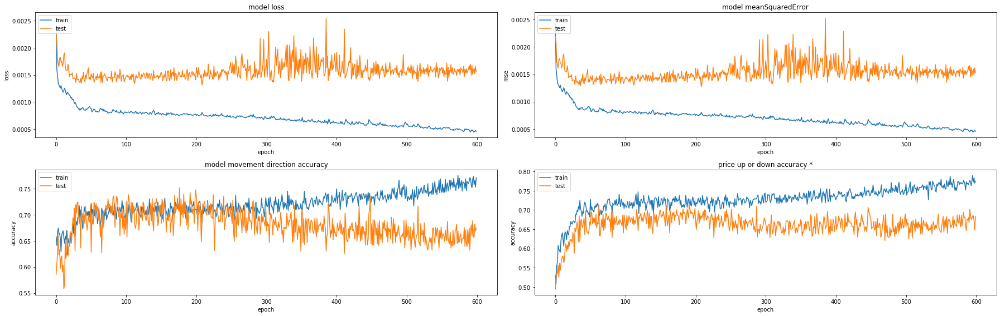

223/223 [==============================] - 1s 5ms/step - loss: 0.0015 - mean_squared_error: 0.0015 - movement_accuracy: 0.7399 - above_or_below_zero_accuracy: 0.7130
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


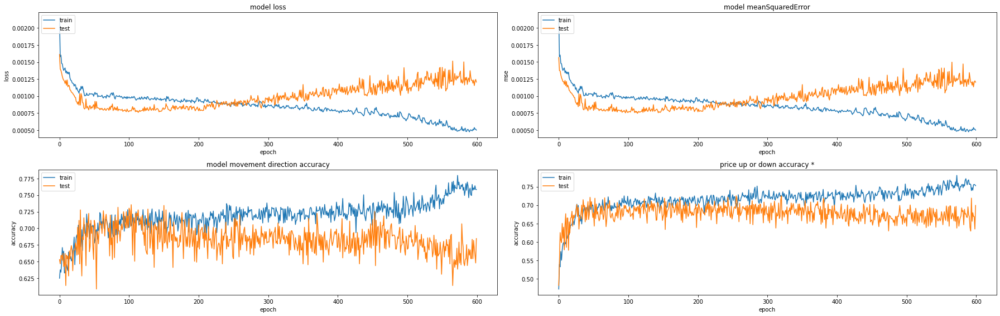

223/223 [==============================] - 1s 5ms/step - loss: 9.1599e-04 - mean_squared_error: 9.1599e-04 - movement_accuracy: 0.7085 - above_or_below_zero_accuracy: 0.7265
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


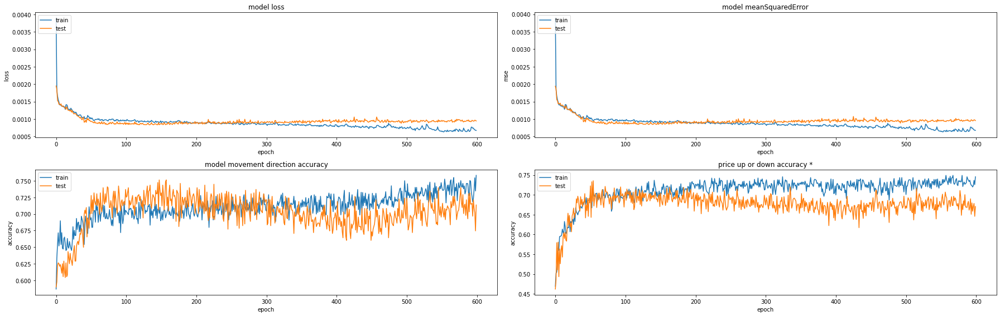

224/224 [==============================] - 1s 5ms/step - loss: 8.8888e-04 - mean_squared_error: 8.8888e-04 - movement_accuracy: 0.7321 - above_or_below_zero_accuracy: 0.7366
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


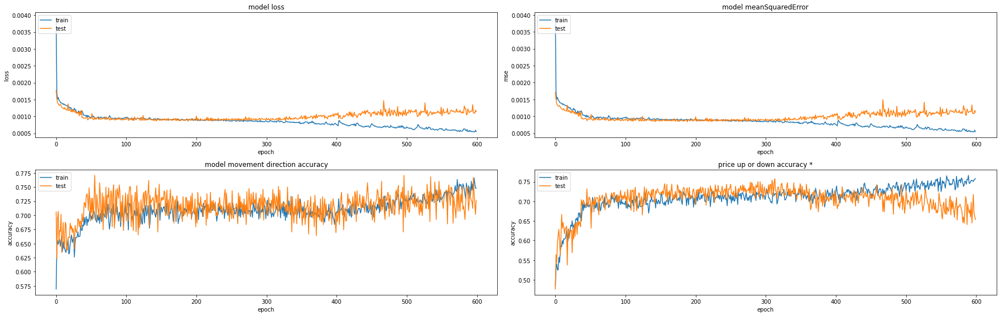

224/224 [==============================] - 1s 5ms/step - loss: 9.0960e-04 - mean_squared_error: 9.0960e-04 - movement_accuracy: 0.7098 - above_or_below_zero_accuracy: 0.7589
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


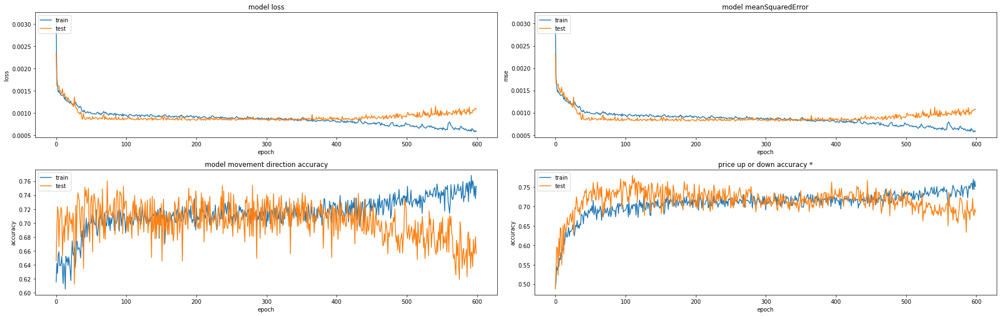

223/223 [==============================] - 1s 5ms/step - loss: 8.5445e-04 - mean_squared_error: 8.5445e-04 - movement_accuracy: 0.7309 - above_or_below_zero_accuracy: 0.7713
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


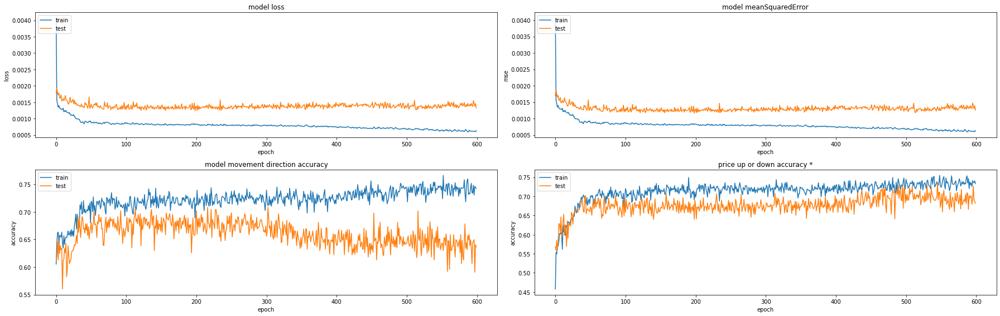

223/223 [==============================] - 1s 5ms/step - loss: 0.0014 - mean_squared_error: 0.0014 - movement_accuracy: 0.6278 - above_or_below_zero_accuracy: 0.7354
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


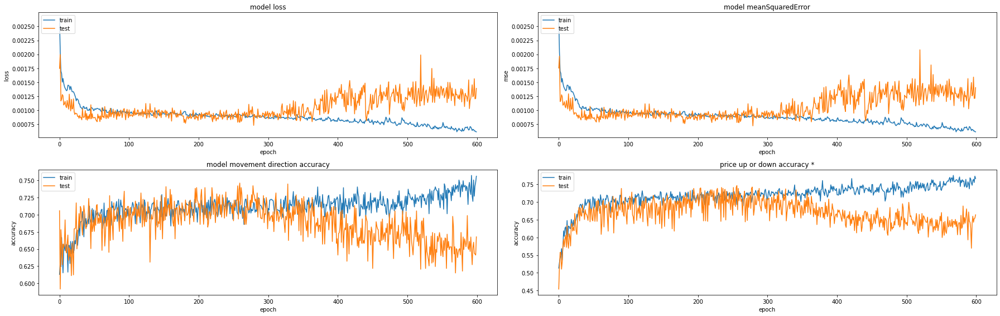

223/223 [==============================] - 1s 6ms/step - loss: 7.8402e-04 - mean_squared_error: 7.8402e-04 - movement_accuracy: 0.7444 - above_or_below_zero_accuracy: 0.7399

Results:

MeanSquaredError: [0.0008161511505022645, 0.0008124347659759223, 0.0008504890138283372, 0.0013116275658831, 0.0007587099680677056, 0.0008337954641319811, 0.0008580502471886575, 0.0008244673372246325, 0.001241287449374795, 0.0007283704471774399]
MovementDiretionAccuracy: [0.75, 0.7678571343421936, 0.7443946003913879, 0.7488788962364197, 0.7354260087013245, 0.75, 0.7678571343421936, 0.7578475475311279, 0.6995515823364258, 0.7443946003913879]
AboveOrBellowAccuracy: [0.7544642686843872, 0.7633928656578064, 0.7578475475311279, 0.713004469871521, 0.726457417011261, 0.7366071343421936, 0.7589285969734192, 0.7713004350662231, 0.7354260087013245, 0.7399103045463562]

MeanSquaredError mean: 0.0009035383409354836
MovementDiretionAccuracy mean: 0.7466207504272461
AboveOrBellowAccuracy mean: 0.7457339048385621

MeanS

In [23]:
features = [variation, volume_variation]
target = variation

build_and_run_and_show(features, target, mean_squared_error, shuffle_mask = shuffle_mask, epochs = 600)  # nao teve overfitting até o epoch 400, entao bora forçar mais uns pra ver se tira mais ganho
print(f'Esse é o score do {base_coin_fullname_str} num modelo treinado por ele mesmo (mesma moeda, mas trechos de dados diferentes)\n foi usada validação cruzada (K-Fold)')